In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import itertools
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

/var/folders/dn/t8s0kyv52pbfv6q_x3r132rw0000gn/T/ipykernel_15892/331207659.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [3]:
df= pd.read_csv('/Users/pranjalmishra/Desktop/big_data_analysis/final_dataset.csv')
df

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze,prognosis,PRECAU,RISKFAC,Medicine_Name,Medicine_Composition,Medicine_Description
0,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,Fungal infection,"Bath twice, use dettol or neem in bathing wate...","Colonization, broad-spectrum antibiotics, indw...",Antifungal cream,"clotrimazole, econazole, ketoconazole, miconaz...",a pharmaceutical fungicide or fungistatic used...
1,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,Fungal infection,"Bath twice, use dettol or neem in bathing wate...","Colonization, broad-spectrum antibiotics, indw...",Antifungal liquids,"clotrimazole, econazole, ketoconazole, miconaz...",a pharmaceutical fungicide or fungistatic used...
2,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,Fungal infection,"Bath twice, use dettol or neem in bathing wate...","Colonization, broad-spectrum antibiotics, indw...",Antifungal sprays,"clotrimazole, econazole, ketoconazole, miconaz...",a pharmaceutical fungicide or fungistatic used...
3,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,Fungal infection,"Bath twice, use dettol or neem in bathing wate...","Colonization, broad-spectrum antibiotics, indw...",Antifungal cream,"clotrimazole, econazole, ketoconazole, miconaz...",a pharmaceutical fungicide or fungistatic used...
4,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,Fungal infection,"Bath twice, use dettol or neem in bathing wate...","Colonization, broad-spectrum antibiotics, indw...",Antifungal liquids,"clotrimazole, econazole, ketoconazole, miconaz...",a pharmaceutical fungicide or fungistatic used...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,Urinary tract infection,"Drink plenty of water, increase vitamin c inta...","Being women, Women who use diaphragms, A suppr...",Penicillin,"VK (Penicillin V Potassium Tablets USP), for o...",treat uncomplicated community acquired pneumon...
7196,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,Urinary tract infection,"Drink plenty of water, increase vitamin c inta...","Being women, Women who use diaphragms, A suppr...",Isoniazid (antibiotics),"silicon dioxide, lactose monohydrate, pregelat...",Isoniazid is an antibiotic used for the treatm...
7197,0,1,0,0,0,0,1,0,0,0,...,1,0,0,0,Psoriasis,"Wash hands with warm soapy water, stop bleedin...","Family history, Viral and bacterial infections...",steroid,"17carbon atom, bonded in 4 fused ring, 3 6-mem...","are chemicals, that your body makes naturally ..."
7198,0,1,0,0,0,0,0,0,0,0,...,0,1,1,1,Impetigo,"Wash your hands often with soap and water, use...","Diabetes, weakened immune system, children age...",Penicillin,"VK (Penicillin V Potassium Tablets USP), for o...",treat uncomplicated community acquired pneumon...


In [3]:
df.shape 

(7200, 138)

In [4]:
df.isnull().any()

itching                 False
skin_rash               False
nodal_skin_eruptions    False
continuous_sneezing     False
shivering               False
                        ...  
PRECAU                   True
RISKFAC                  True
Medicine_Name            True
Medicine_Composition     True
Medicine_Description     True
Length: 138, dtype: bool

In [5]:
df['prognosis'].unique()

array(['Fungal infection', 'Allergy', 'GERD', 'Chronic cholestasis',
       'Drug Reaction', 'Peptic ulcer diseae', 'AIDS', 'Diabetes ',
       'Gastroenteritis', 'Bronchial Asthma', 'Hypertension ', 'Migraine',
       'Cervical spondylosis', 'Paralysis (brain hemorrhage)', 'Jaundice',
       'Malaria', 'Chicken pox', 'Dengue', 'Typhoid', 'hepatitis A',
       'Hepatitis B', 'Hepatitis C', 'Hepatitis D', 'Hepatitis E',
       'Alcoholic hepatitis', 'Tuberculosis', 'Common Cold', 'Pneumonia',
       'Dimorphic hemmorhoids(piles)', 'Heart attack', 'Varicose veins',
       'Hypothyroidism', 'Hyperthyroidism', 'Hypoglycemia',
       'Osteoarthristis', 'Arthritis',
       '(vertigo) Paroymsal  Positional Vertigo', 'Acne',
       'Urinary tract infection', 'Psoriasis', 'Impetigo'], dtype=object)

In [6]:
df['prognosis'].nunique()

41

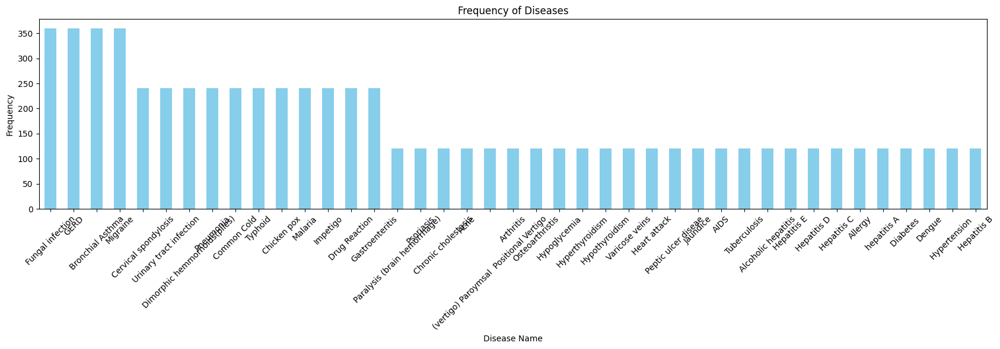

In [7]:
plt.figure(figsize=(17, 6))  
df['prognosis'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Frequency of Diseases')
plt.xlabel('Disease Name')
plt.ylabel('Frequency')
plt.xticks(rotation=45)  
plt.tight_layout() 
plt.show()

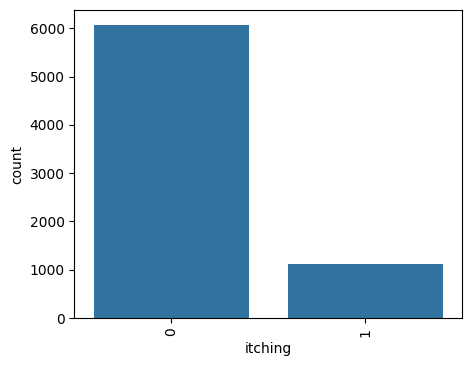

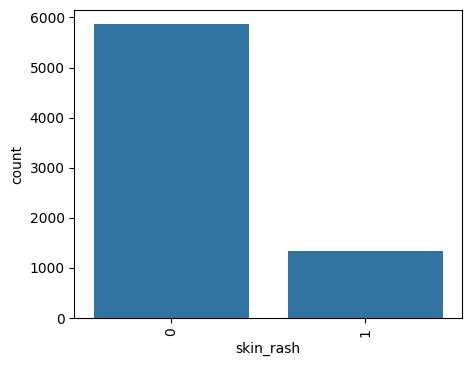

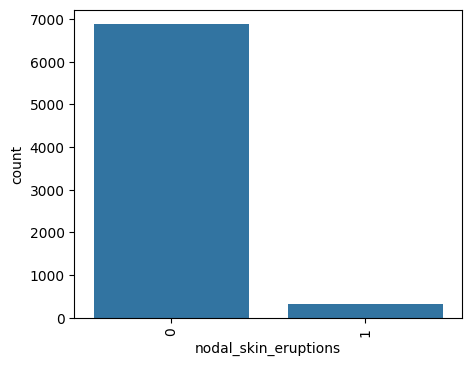

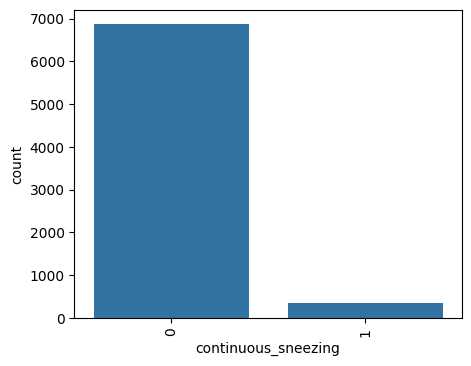

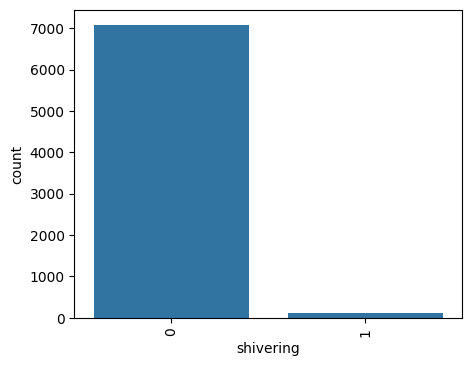

...

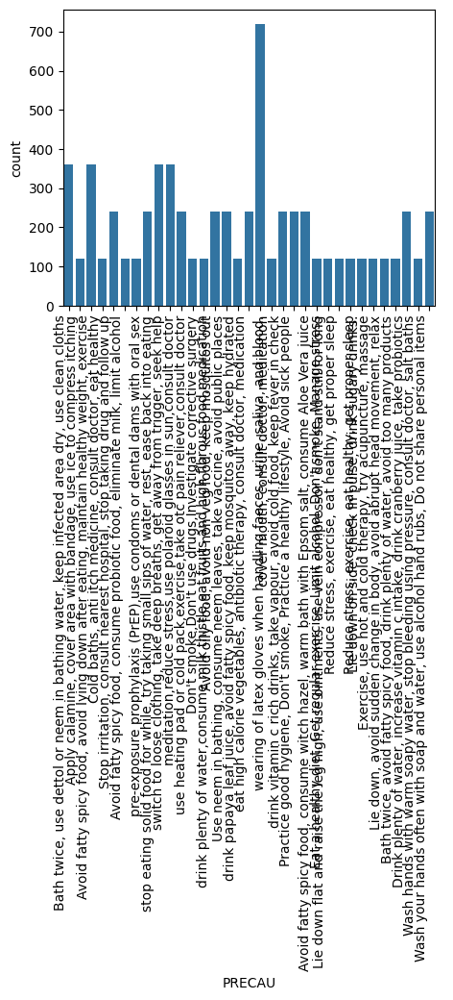

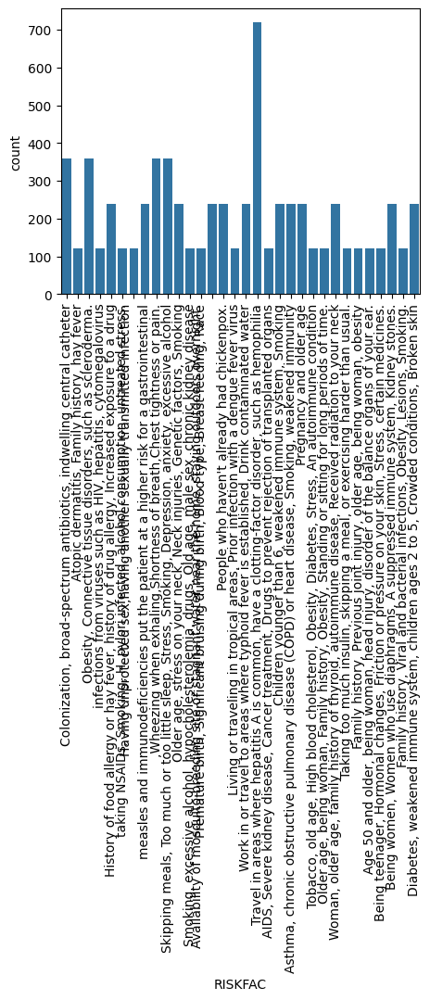

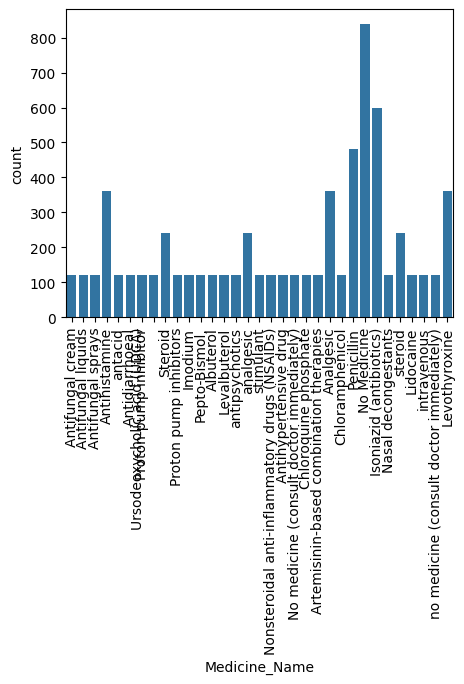

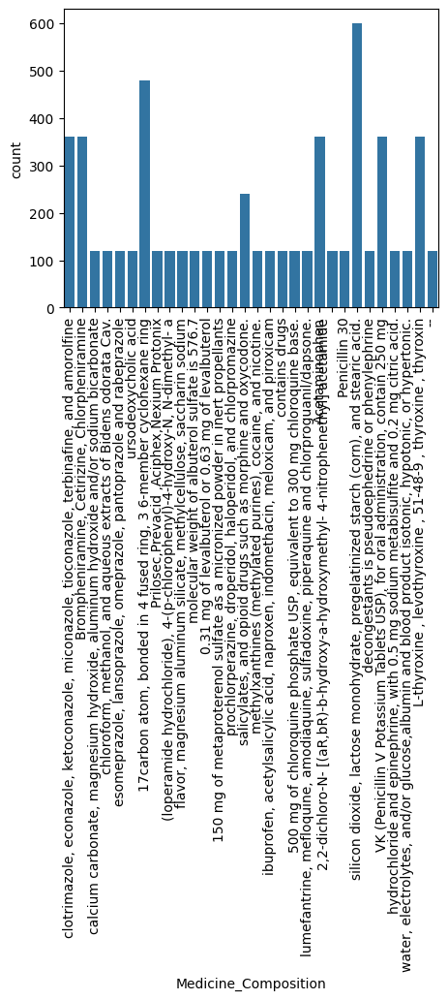

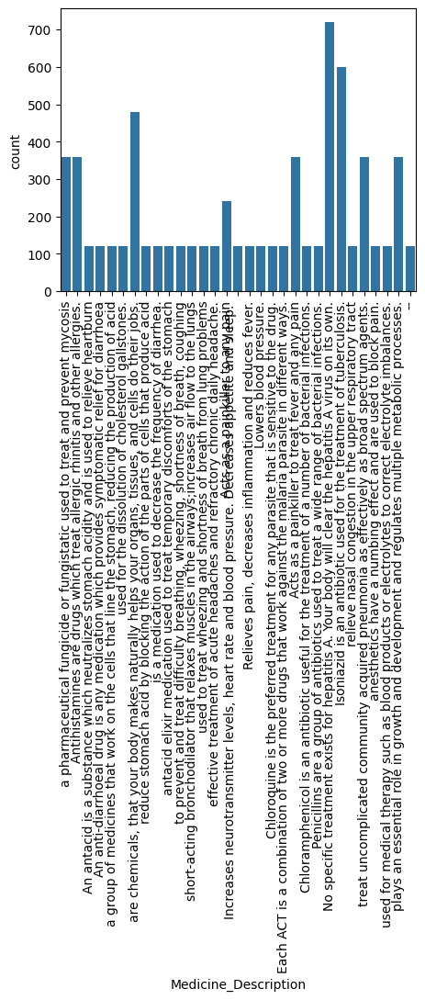

In [8]:
for column in df.columns:
    fig=plt.figure(figsize=(5,4))
    sns.countplot(data=df,x=column)
    plt.xticks(rotation=90)
    plt.xlabel(column)
    plt.show()
    

## Plot of count of symptoms wirht respect to each prognosis 

In [9]:
def plot_histograms(data, symptoms, target='prognosis'):
    for symptom in symptoms:
        plt.figure(figsize=(12, 6))
        sns.countplot(data=data, x=target, hue=symptom)
        plt.title(f'Histogram of {symptom} by Prognosis')
        plt.xticks(rotation=90)
        plt.legend(title=symptom)
        plt.tight_layout()
        plt.show()


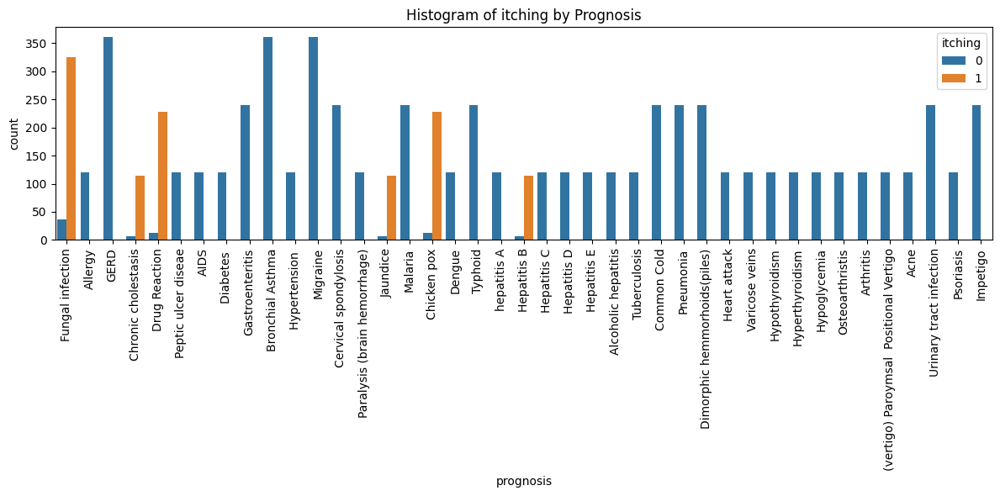

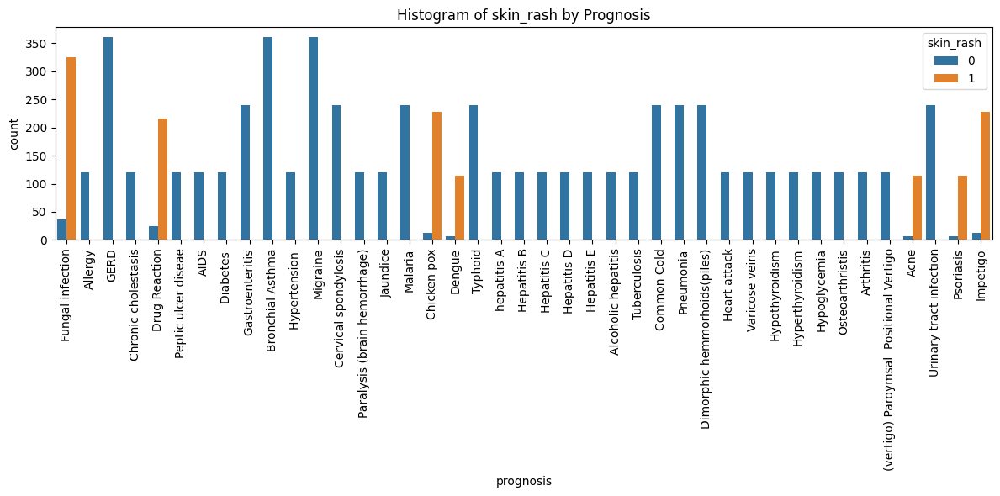

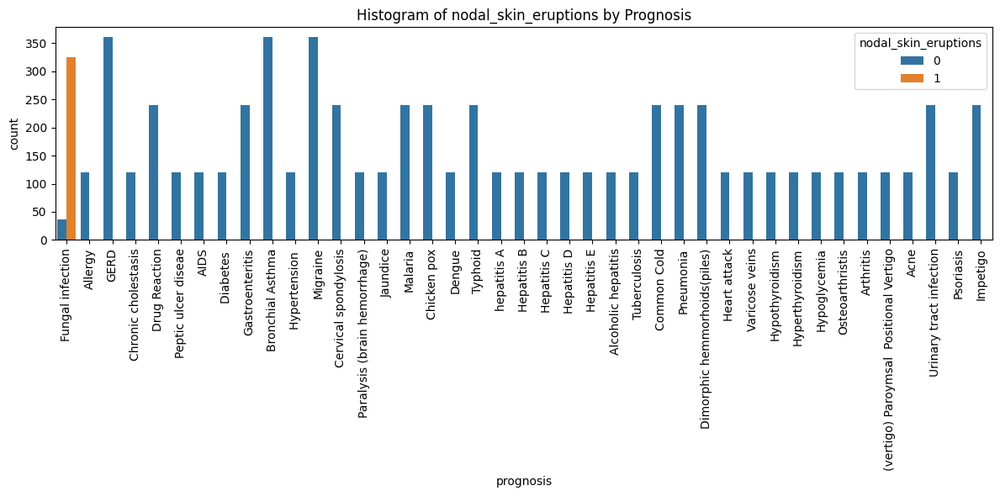

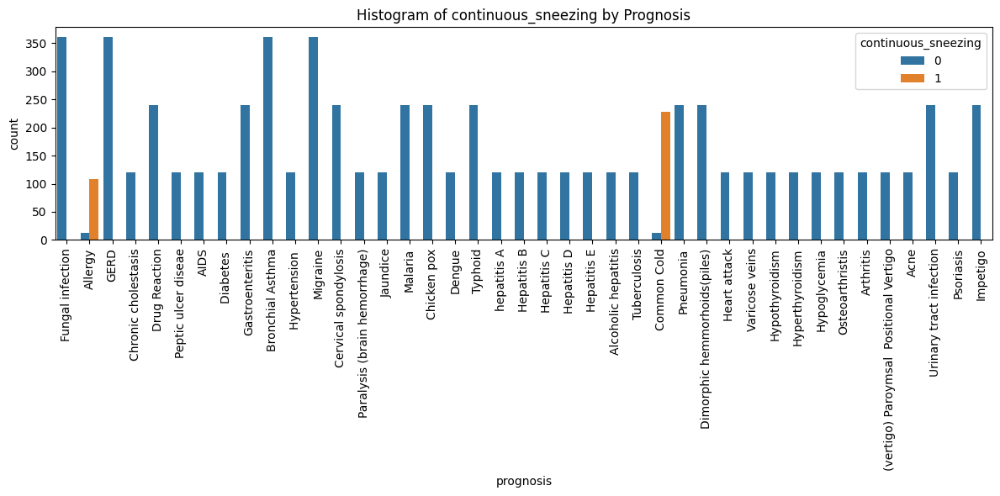

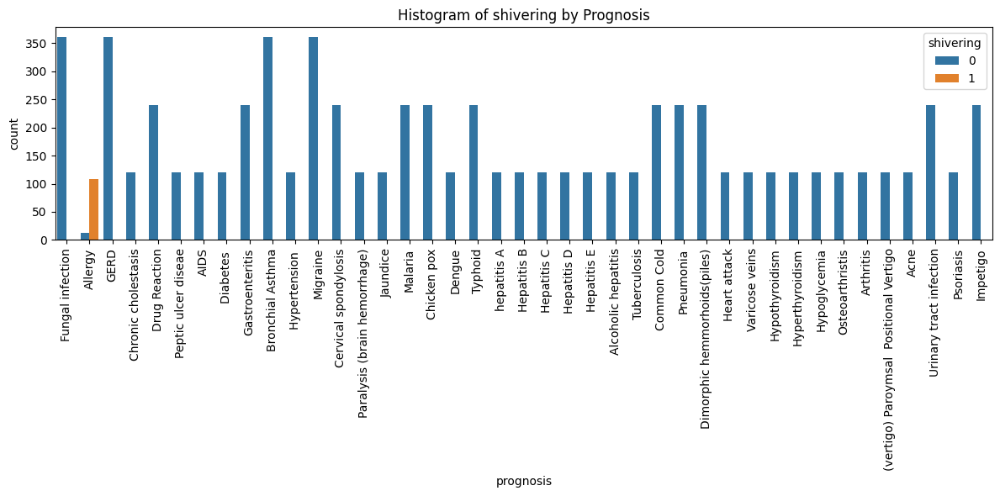

...

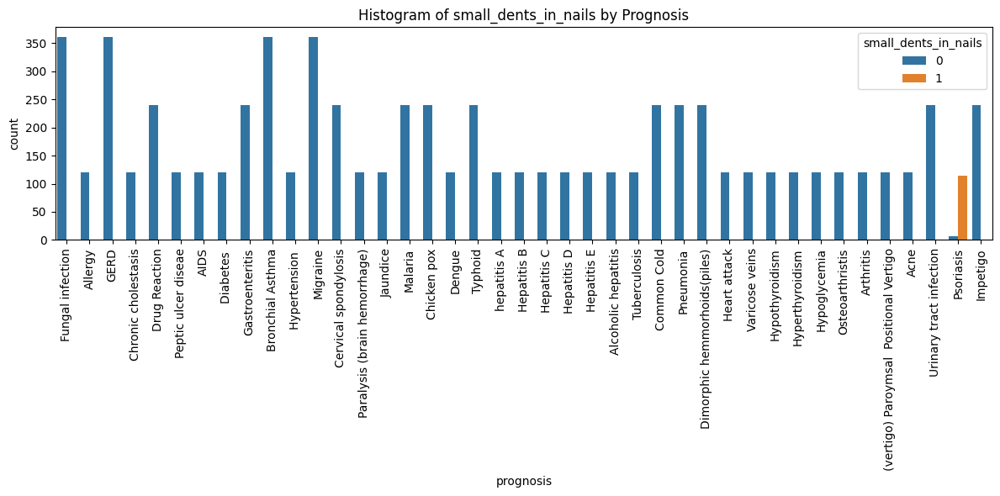

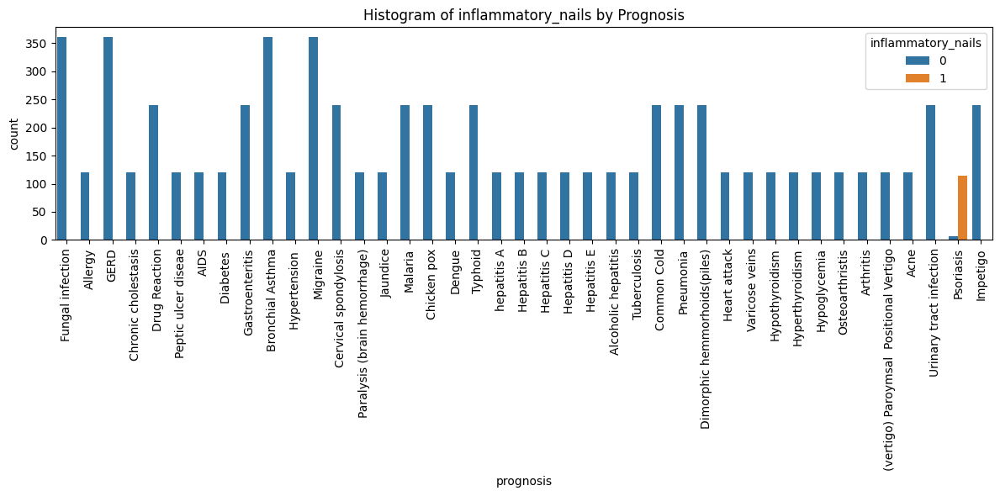

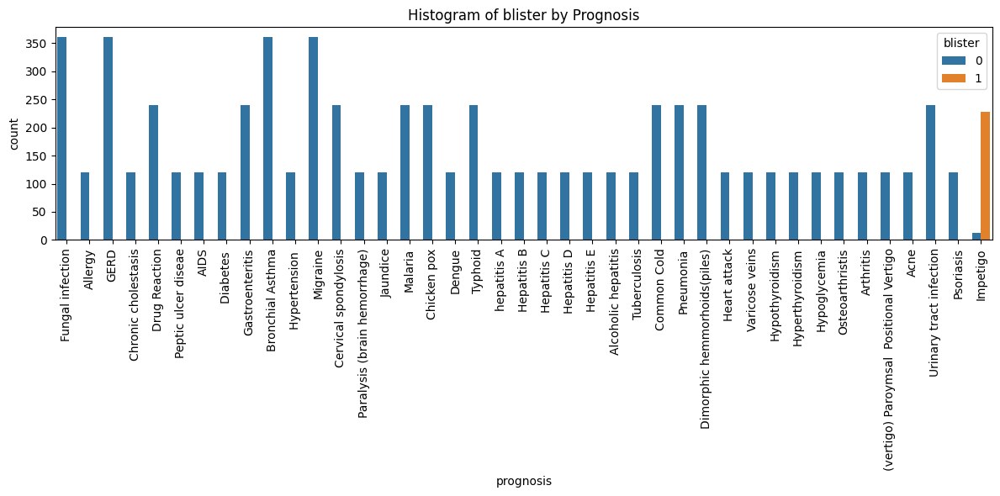

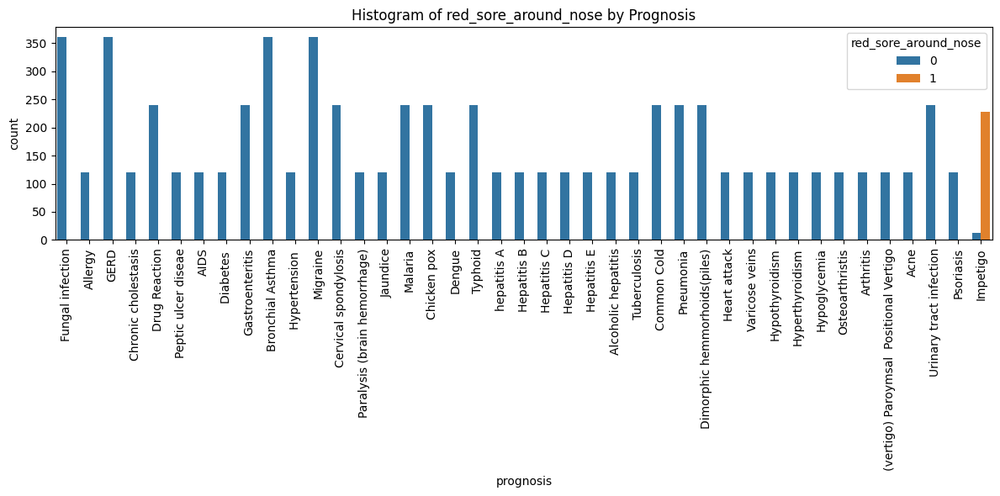

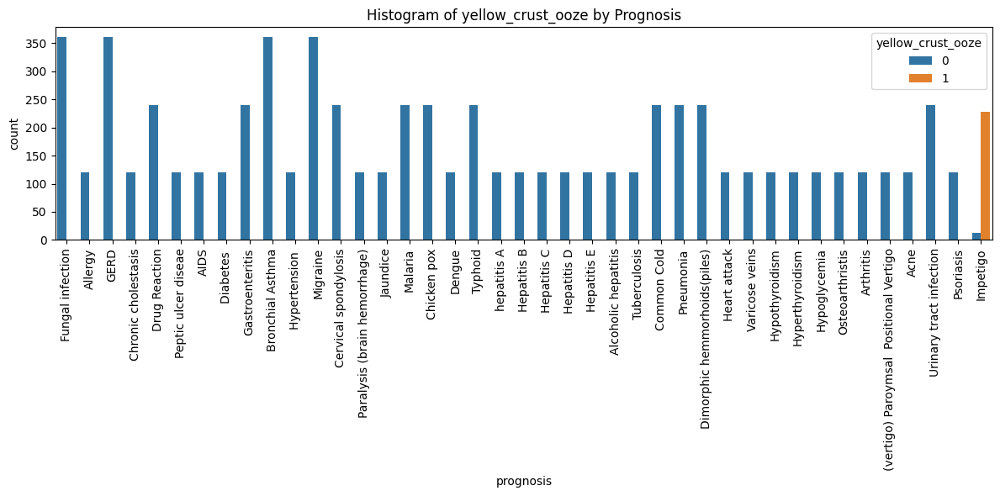

/var/folders/dn/t8s0kyv52pbfv6q_x3r132rw0000gn/T/ipykernel_48347/3122093654.py:8: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


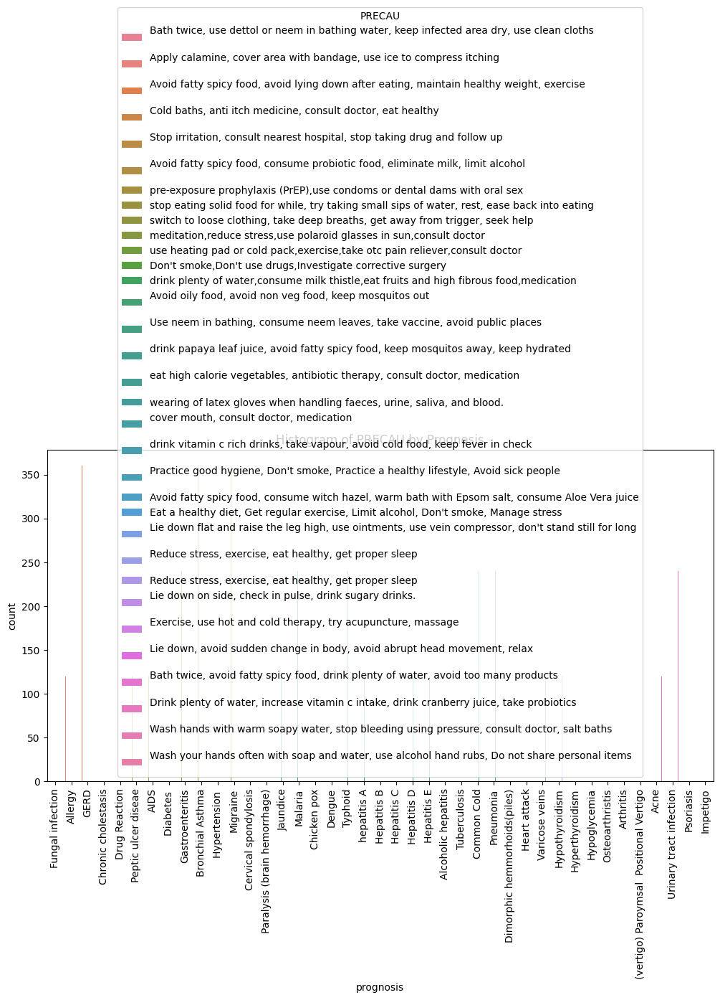

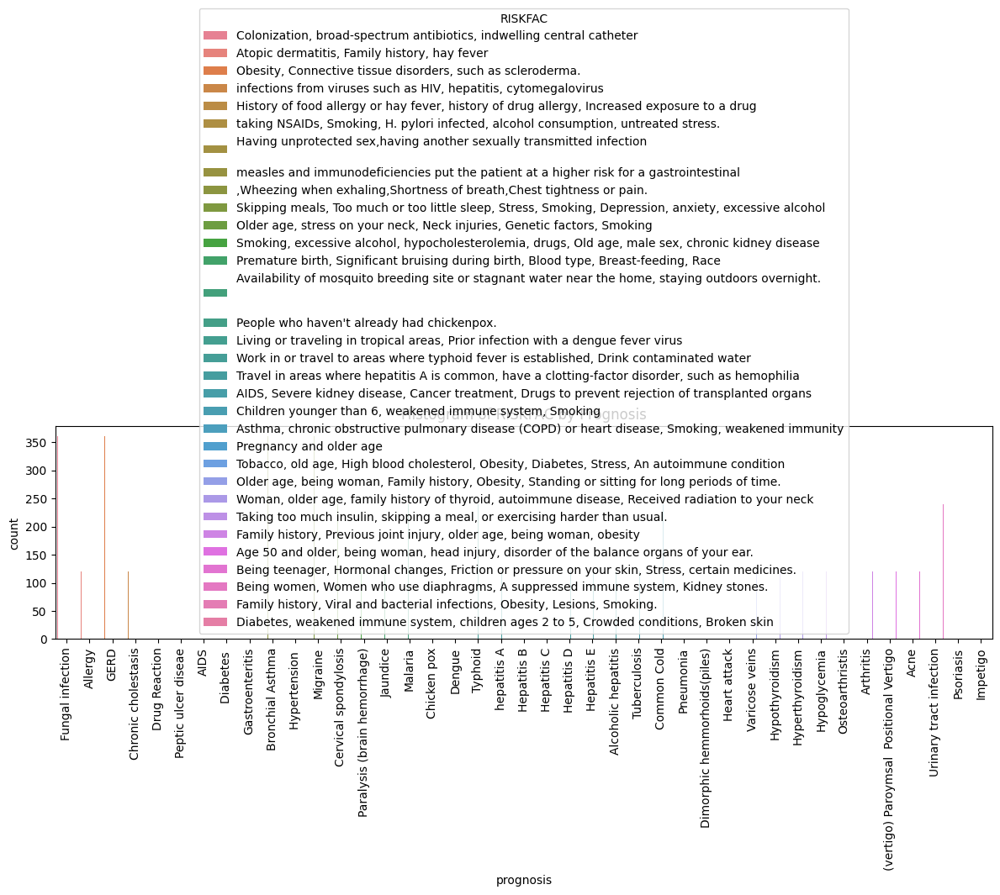

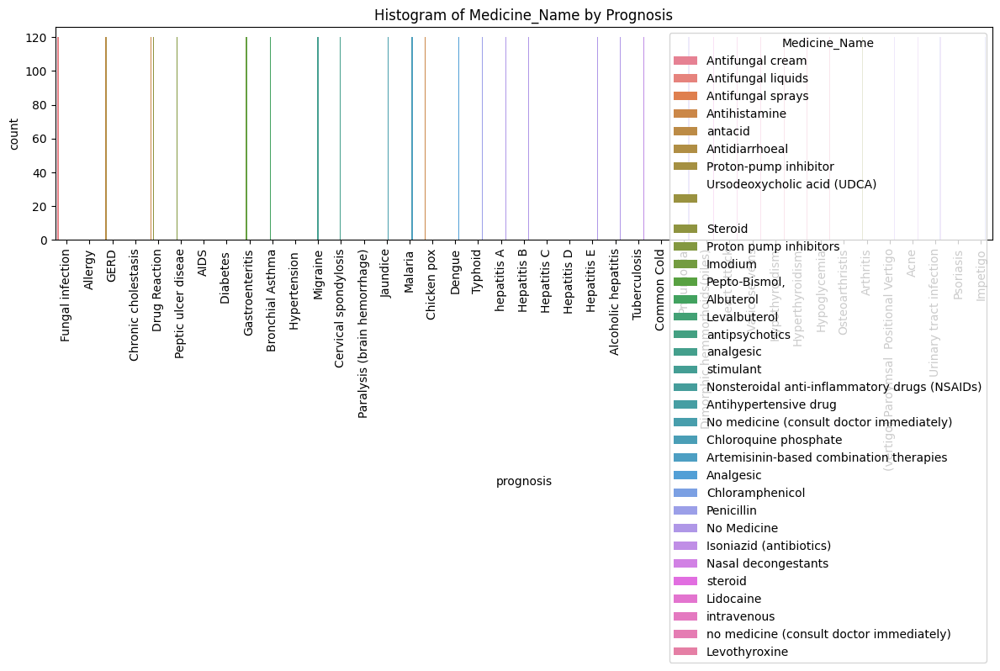

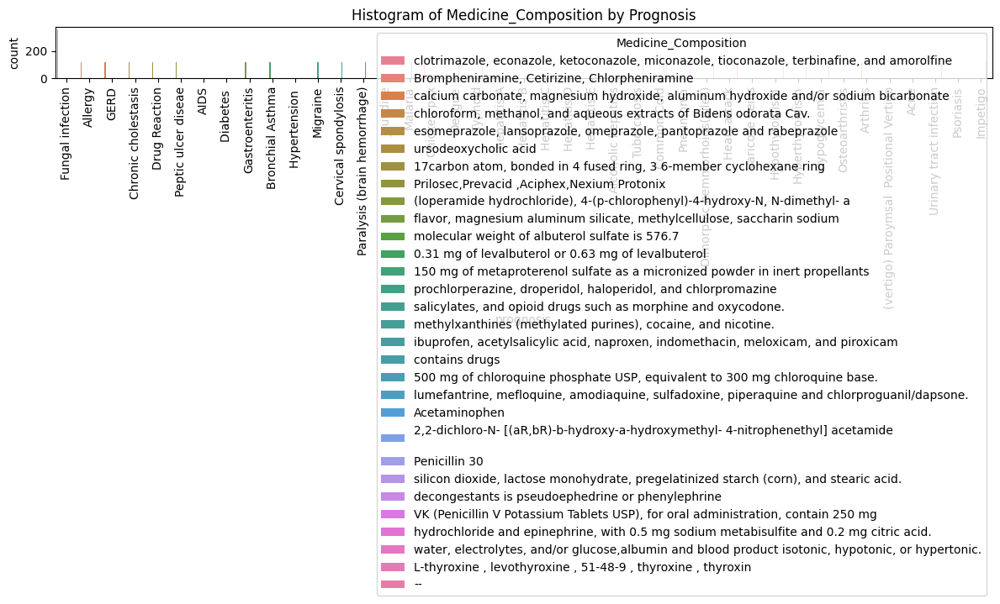

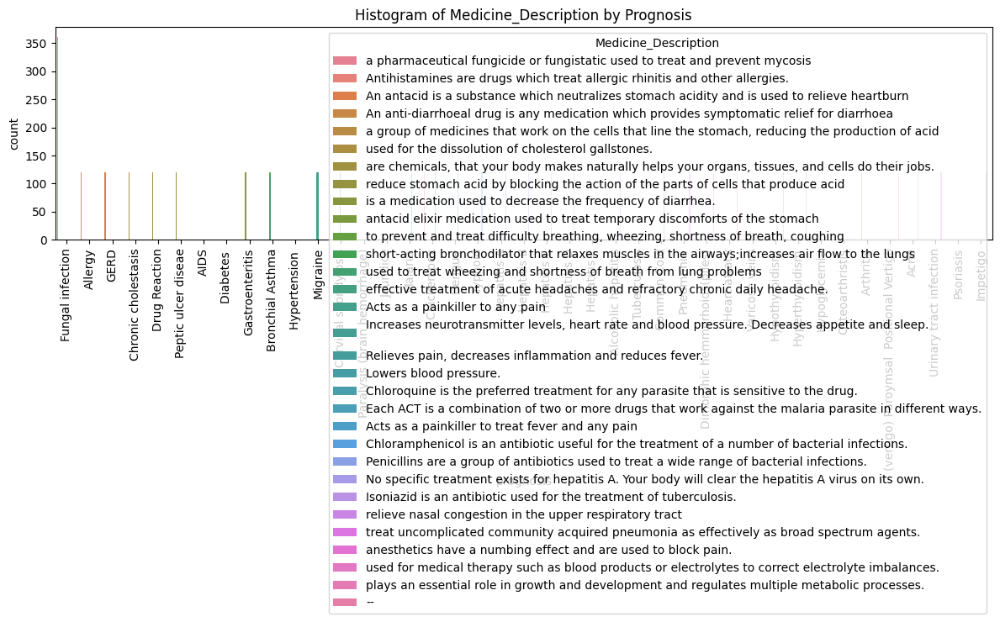

In [10]:
symptoms_list = [col for col in df.columns if col not in ['prognosis']]
plot_histograms(df, symptoms_list)

In [11]:
df.shape

(7200, 138)

In [12]:
def plot_histograms(data, symptoms, target='prognosis'):
    for symptom in symptoms:
        plt.figure(figsize=(12, 6))
        sns.countplot(data=data, x=symptom, hue=target)
        plt.title(f'Prognosis Distribution for {symptom}')
        plt.xlabel(f'Presence of {symptom} (0 = No, 1 = Yes)')
        plt.ylabel('Count of Cases')
        plt.legend(title='Prognosis', bbox_to_anchor=(1.05, 1), loc=2)
        plt.tight_layout()
        plt.show()

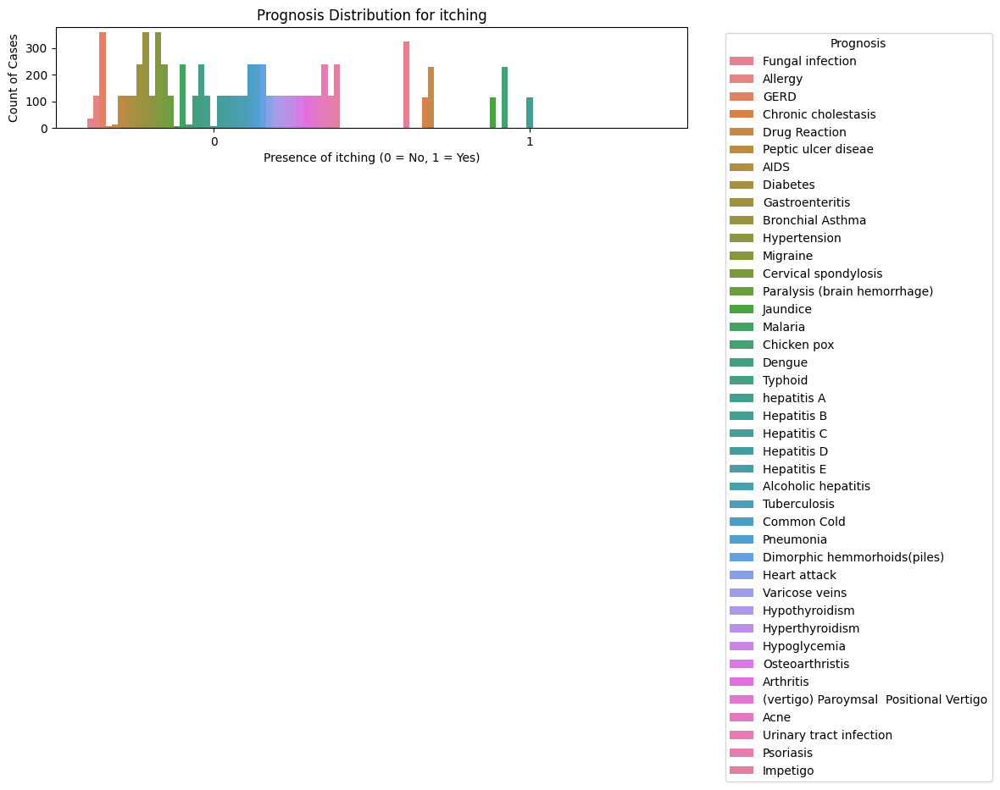

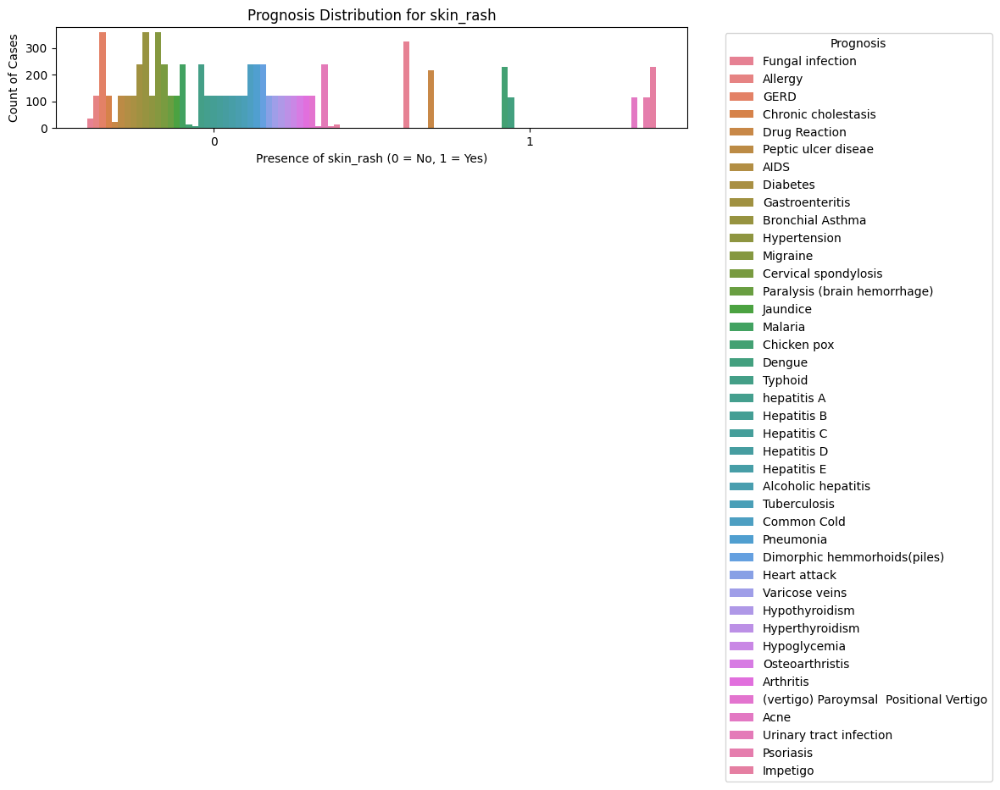

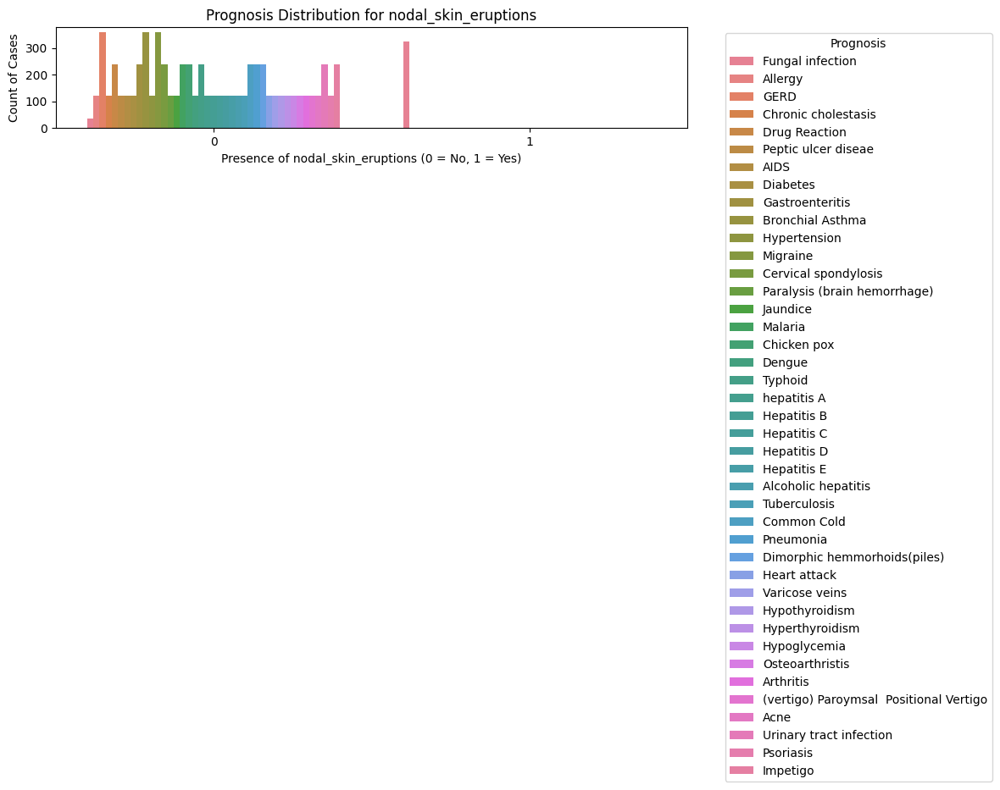

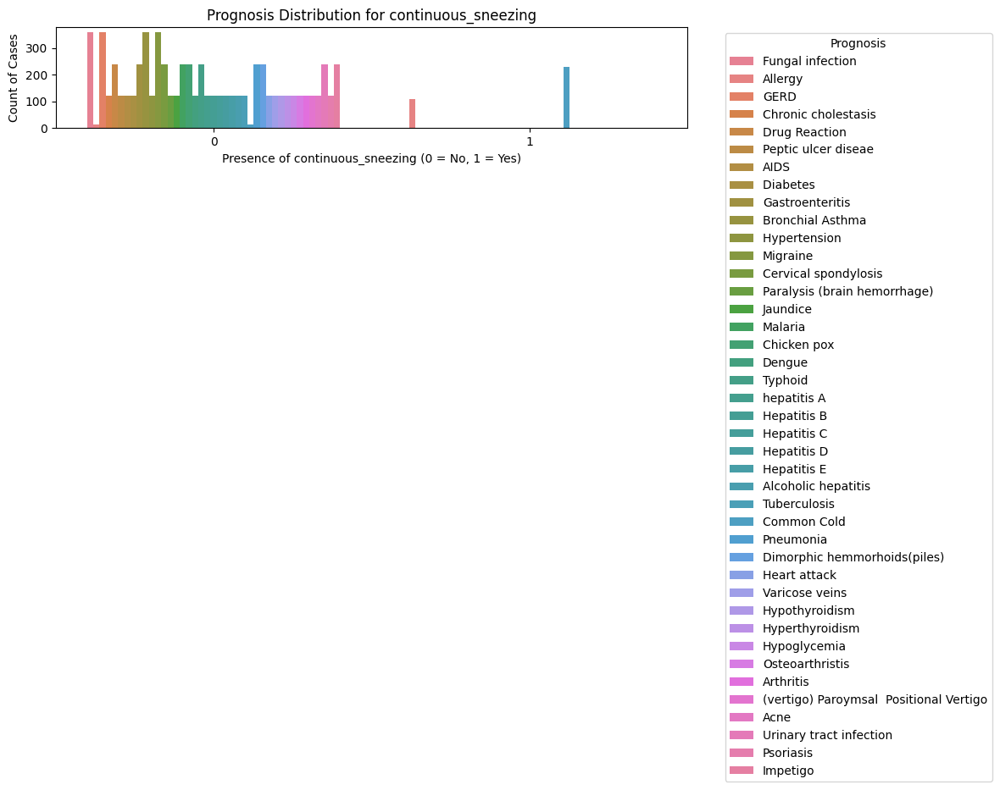

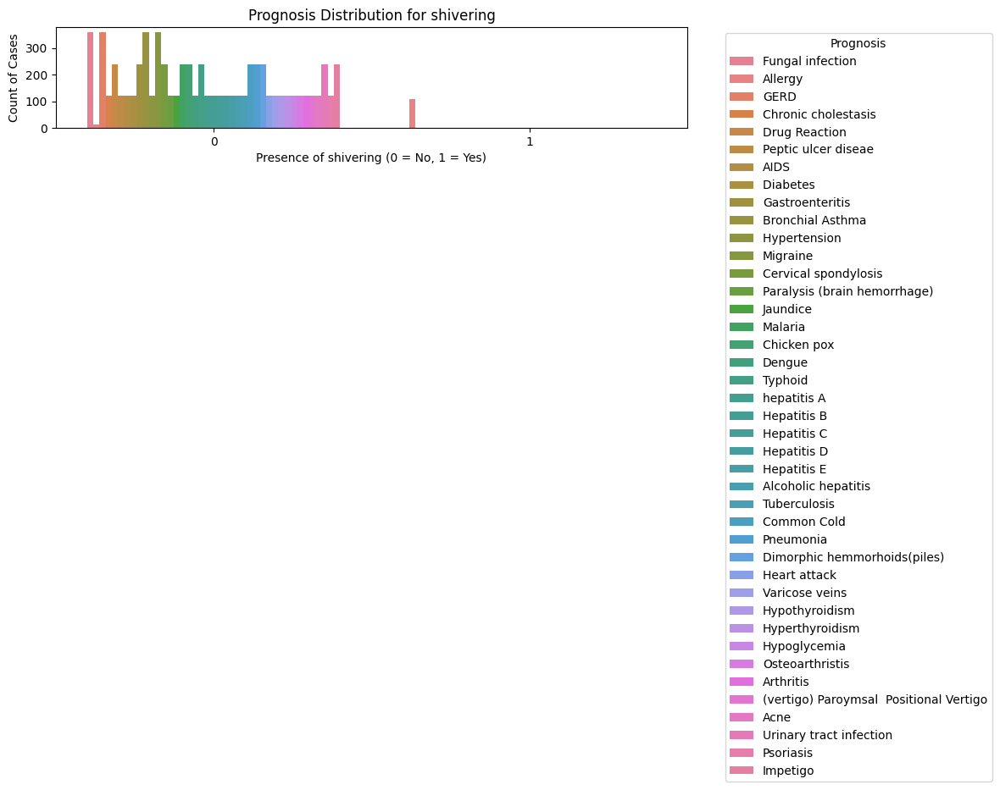

...

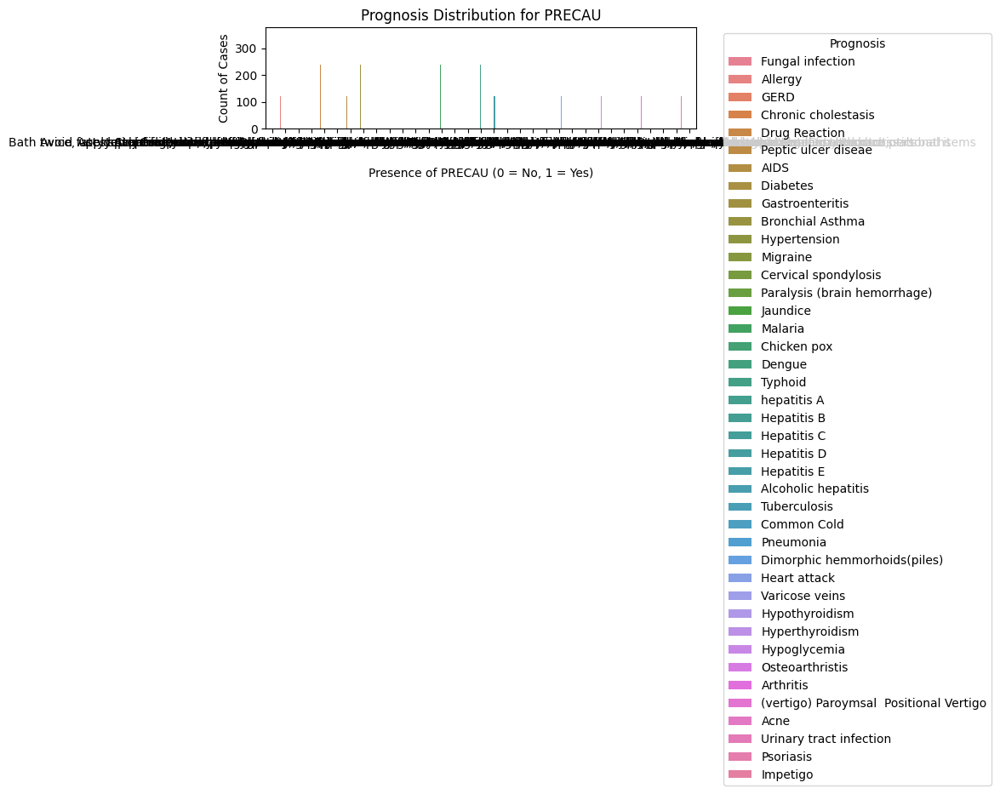

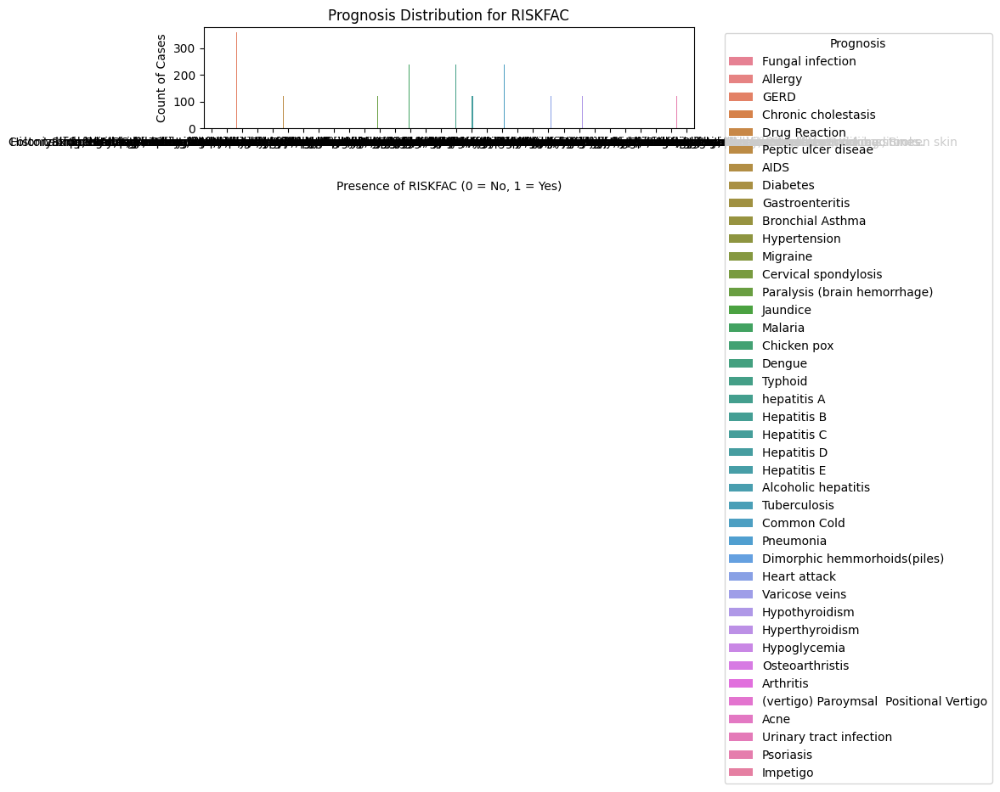

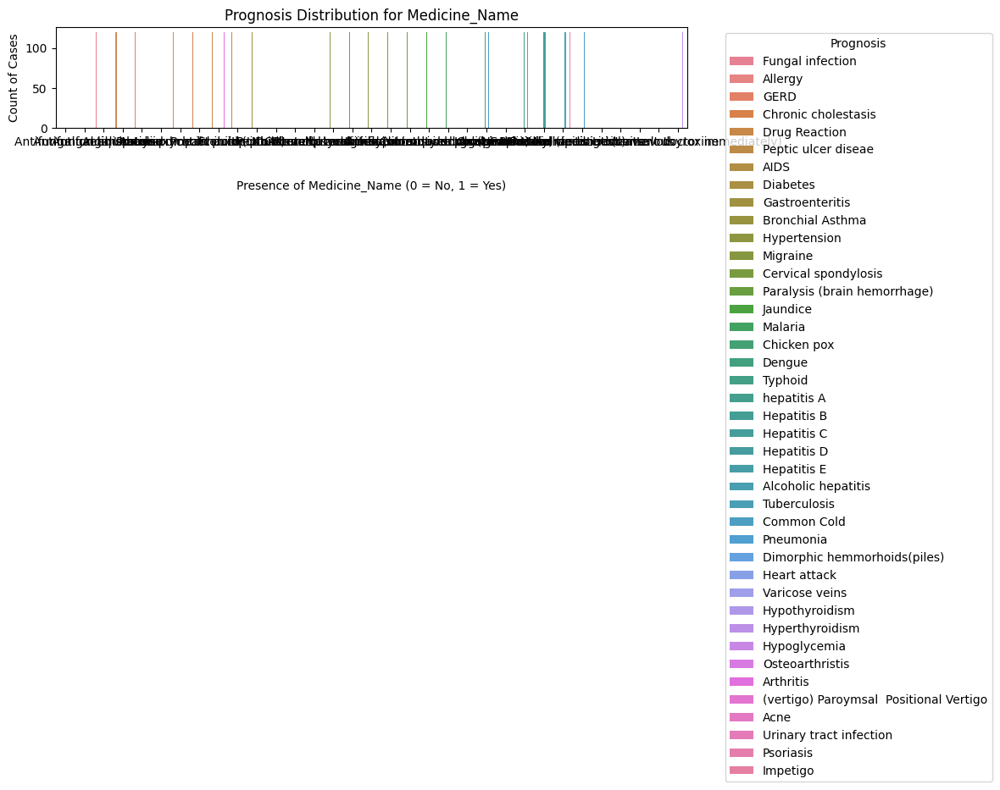

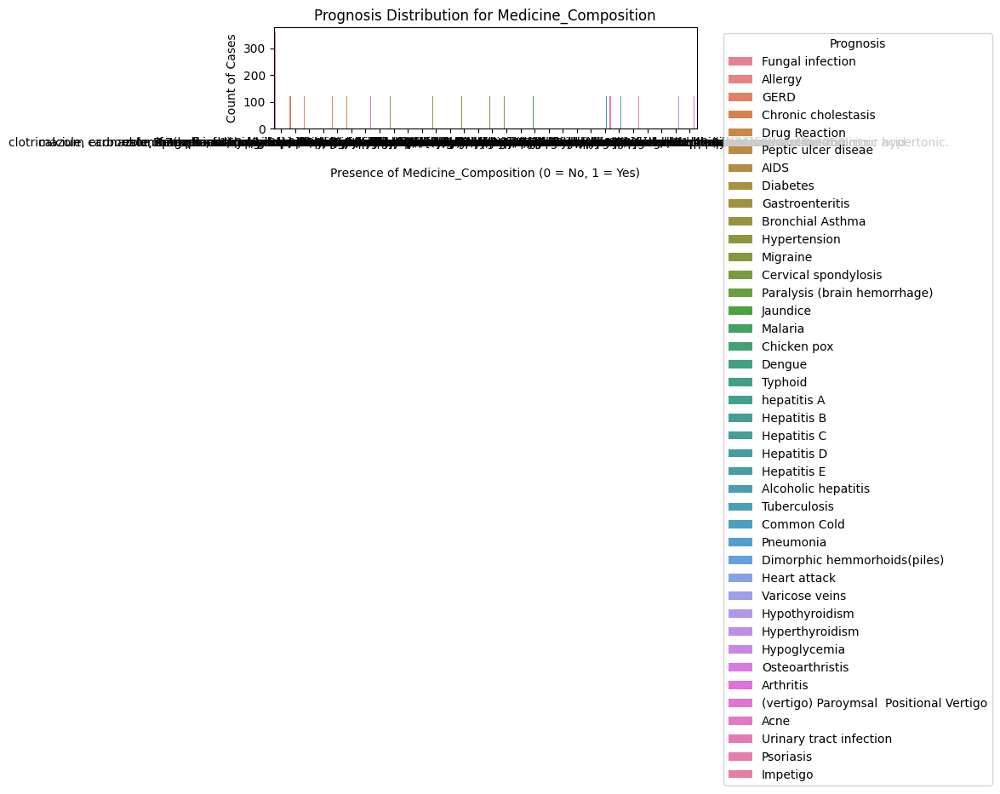

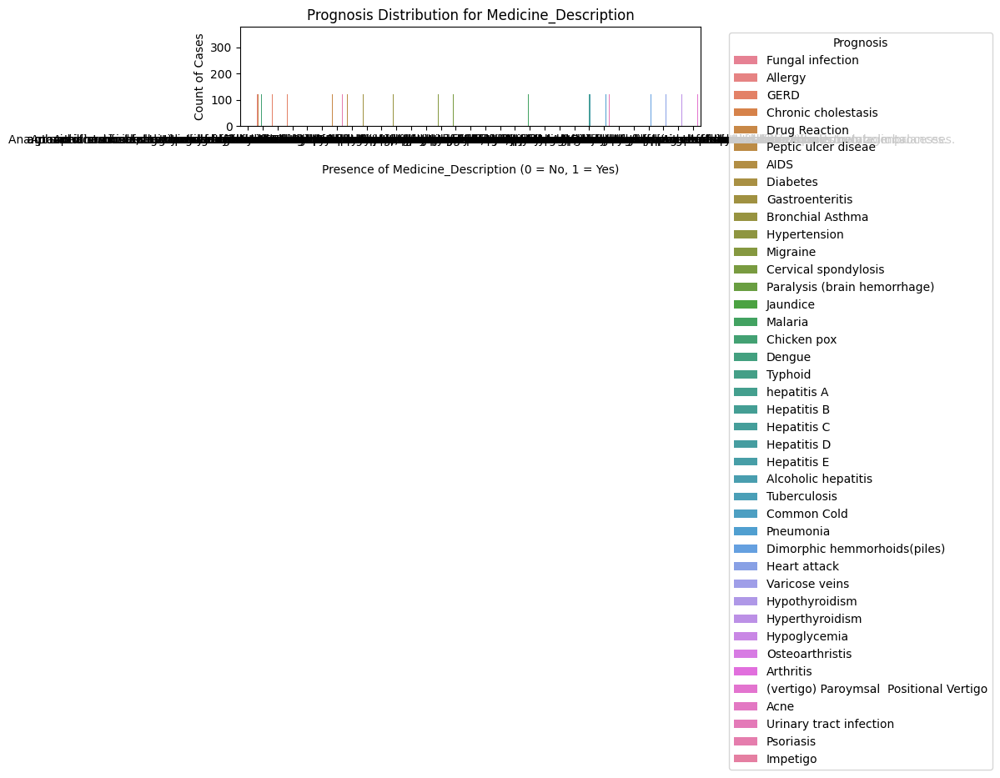

In [13]:
symptoms_list = [col for col in df.columns if col not in ['prognosis']]
plot_histograms(df, symptoms_list)

## Plot for the symptoms present in each prognosis 

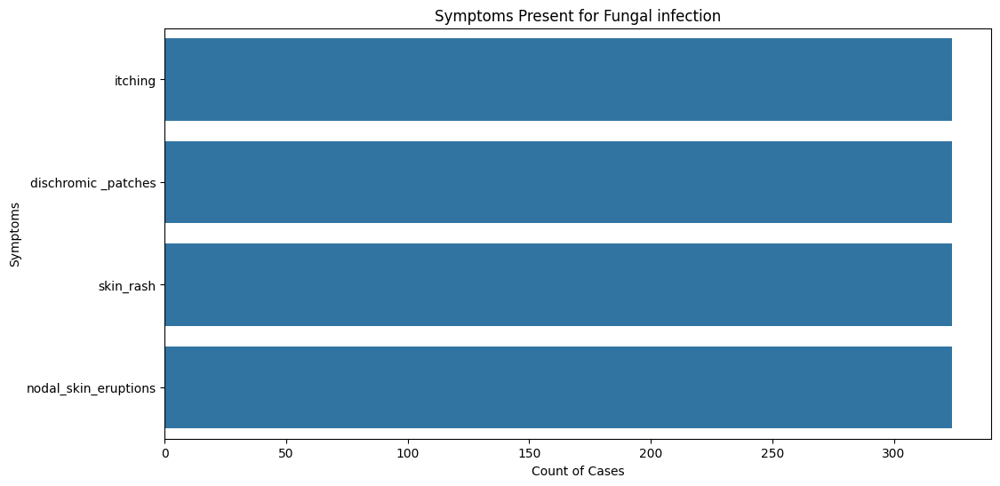

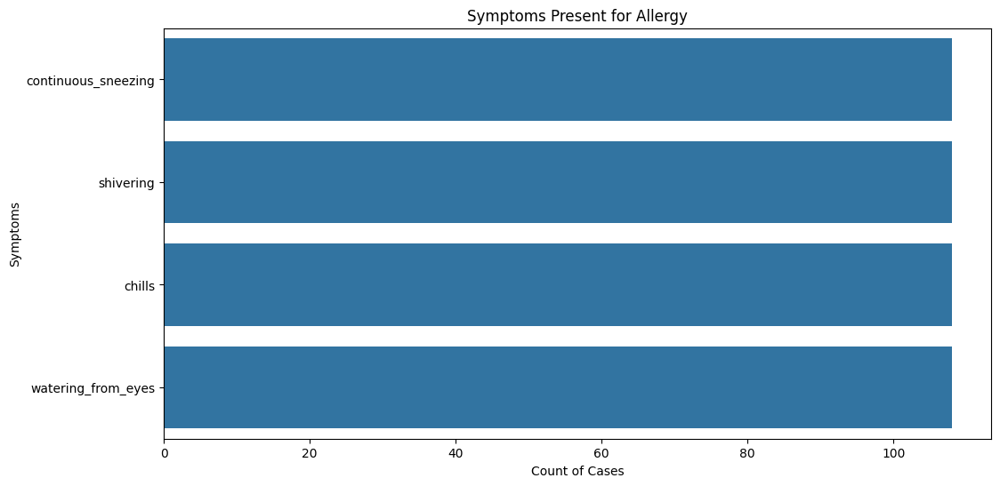

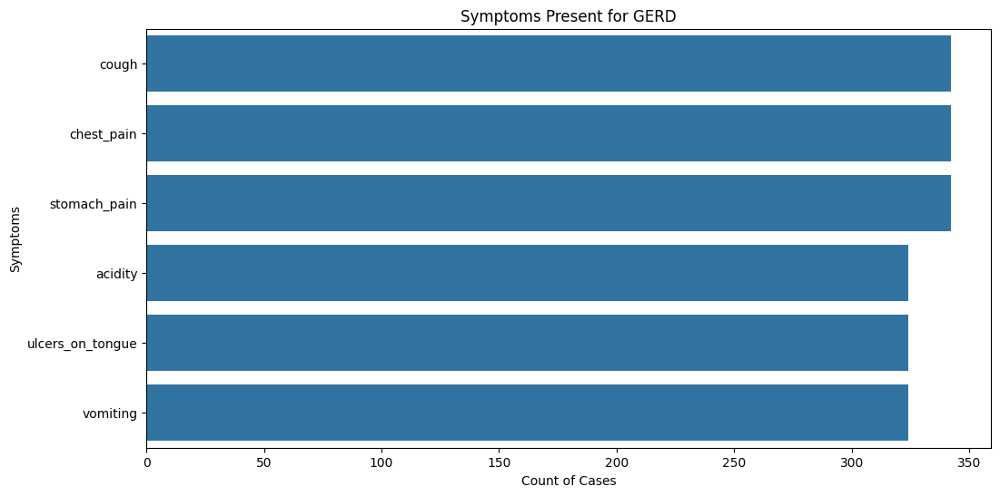

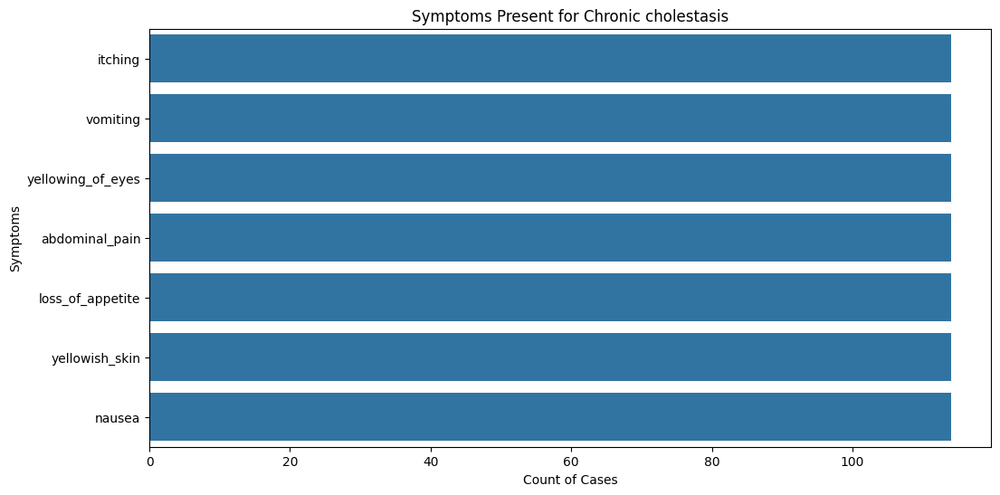

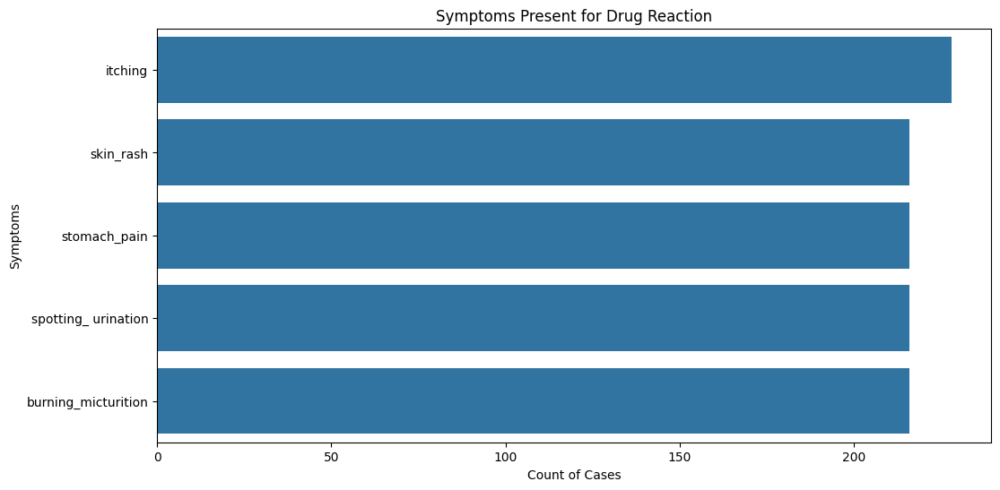

...

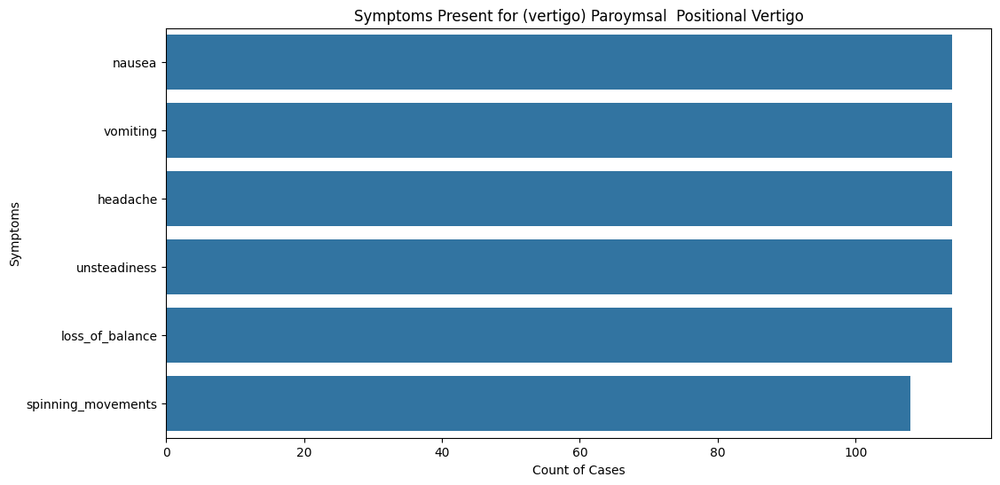

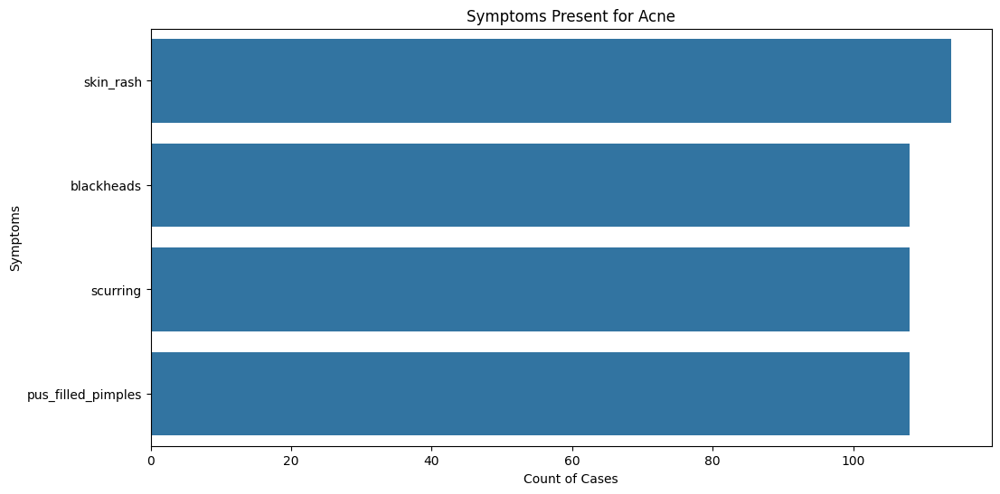

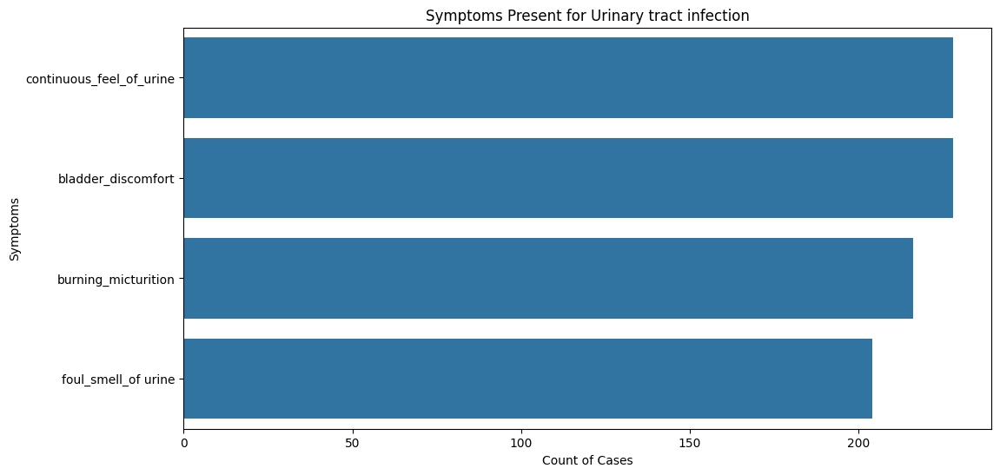

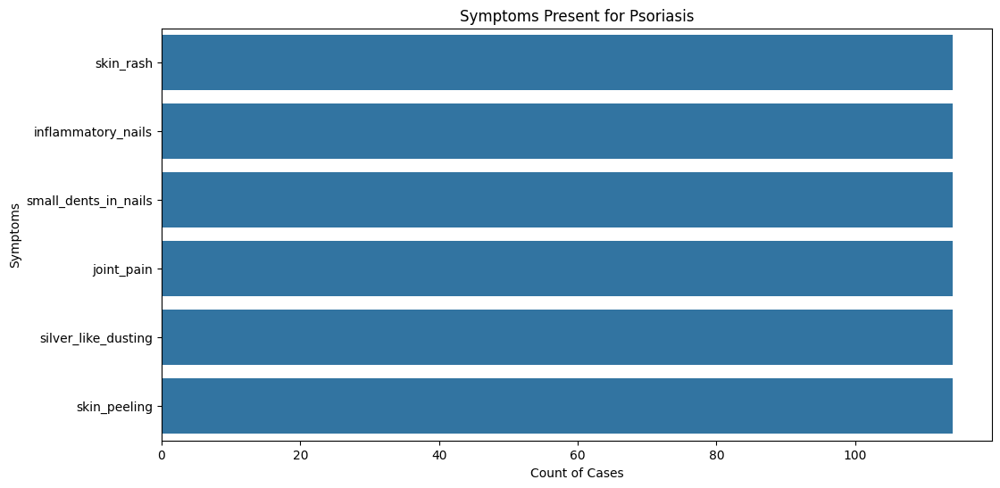

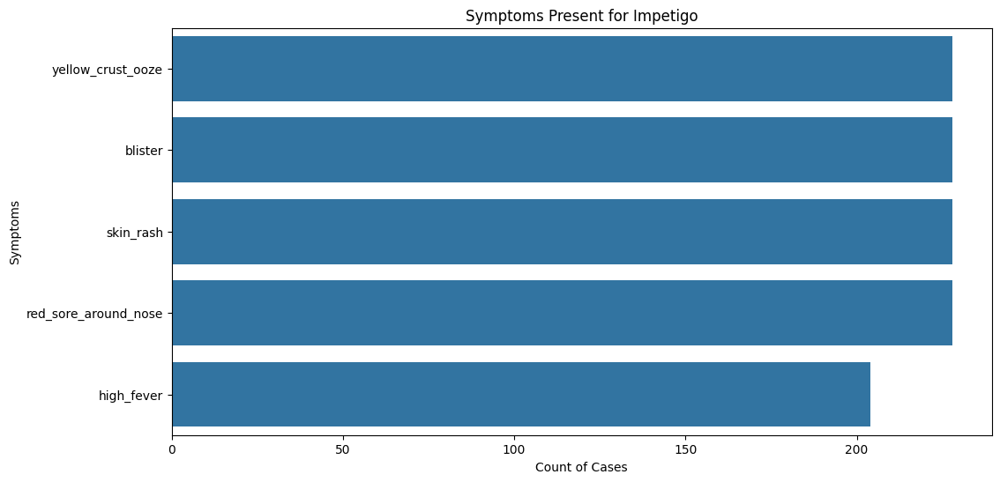

In [14]:
def plot_symptoms_per_prognosis(data, target='prognosis'):
    prognoses = data[target].unique()

    for prognosis in prognoses:
        prognosis_data = data[data[target] == prognosis]

        # Drop non-numeric columns to ensure summing is done only on numeric data
        numeric_columns = prognosis_data.select_dtypes(include=[np.number]).columns.tolist()
        if target in numeric_columns:
            numeric_columns.remove(target)

        symptoms_counts = prognosis_data[numeric_columns].sum().sort_values(ascending=False)
        symptoms_present = symptoms_counts[symptoms_counts > 0]

        if not symptoms_present.empty:
            plt.figure(figsize=(12, 6))
            sns.barplot(x=symptoms_present.values, y=symptoms_present.index)
            plt.title(f'Symptoms Present for {prognosis}')
            plt.xlabel('Count of Cases')
            plt.ylabel('Symptoms')
            plt.show()

# Usage example (assuming 'df' is your DataFrame)
plot_symptoms_per_prognosis(df)

In [15]:
df.shape

(7200, 138)

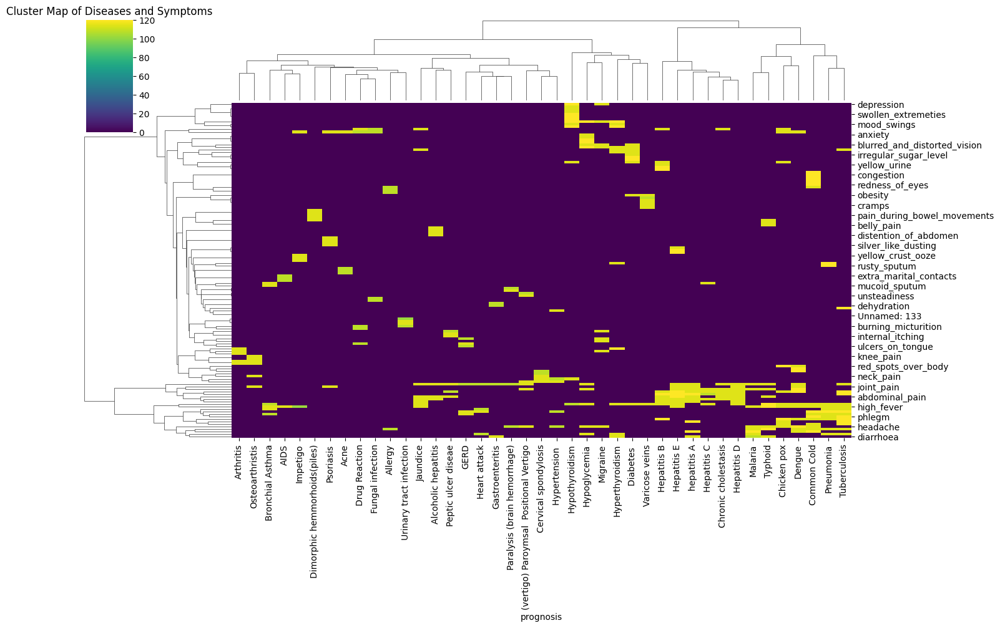

In [16]:
aggregated_data = df.groupby('prognosis').sum().T

# Generate a cluster map using this aggregated data
sns.clustermap(aggregated_data, method='ward', metric='euclidean', cmap='viridis', figsize=(15, 10))
plt.title('Cluster Map of Diseases and Symptoms')
plt.show()

In [17]:
df.describe()

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,pus_filled_pimples,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze
count,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,...,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000,7200.000000
mean,0.155833,0.185833,0.045000,0.046667,0.015000,0.175000,0.095000,0.077500,0.092500,0.045000,...,0.015000,0.015000,0.015000,0.015833,0.015833,0.015833,0.015833,0.031667,0.031667,0.031667
std,0.362722,0.388999,0.207319,0.210939,0.121561,0.379993,0.293235,0.267402,0.289751,0.207319,...,0.121561,0.121561,0.121561,0.124839,0.124839,0.124839,0.124839,0.175123,0.175123,0.175123
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## correlation

In [17]:
columns_to_drop = ['prognosis', 'PRECAU', 'RISKFAC', 'Medicine_Name', 'Medicine_Composition', 'Medicine_Description']
x = df.drop(columns=columns_to_drop, axis=1)
# x=df.drop('prognosis','PRECAU','RISKFAC','Medicine_Name','Medicine_Composition','Medicine_Description',axis=1)
x

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,pus_filled_pimples,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze
0,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7196,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7197,0,1,0,0,0,0,1,0,0,0,...,0,0,0,1,1,1,1,0,0,0
7198,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,1,1


In [19]:
y=df['prognosis']
y

0              Fungal infection
1              Fungal infection
2              Fungal infection
3              Fungal infection
4              Fungal infection
                 ...           
7195    Urinary tract infection
7196    Urinary tract infection
7197                  Psoriasis
7198                   Impetigo
7199                   Impetigo
Name: prognosis, Length: 7200, dtype: object

In [20]:
correlation_matrix = x.corr()
correlation_matrix

,itching,skin_rash,nodal_skin_eruptions,continuous_sneezing,shivering,chills,joint_pain,stomach_pain,acidity,ulcers_on_tongue,...,pus_filled_pimples,blackheads,scurring,skin_peeling,silver_like_dusting,small_dents_in_nails,inflammatory_nails,blister,red_sore_around_nose,yellow_crust_ooze
itching,1.000000,0.491740,0.438730,-0.095060,-0.053020,-0.197883,-0.139205,0.167626,-0.137171,-0.093265,...,-0.053020,-0.053020,-0.053020,-0.054496,-0.054496,-0.054496,-0.054496,-0.077697,-0.077697,-0.077697
skin_rash,0.491740,1.000000,0.392352,-0.105703,-0.058957,-0.118547,0.108247,0.117923,-0.152529,-0.103707,...,0.240673,0.240673,0.240673,0.248327,0.248327,0.248327,0.248327,0.354046,0.354046,0.354046
nodal_skin_eruptions,0.438730,0.392352,1.000000,-0.048027,-0.026787,-0.099976,-0.070330,-0.062918,-0.069303,-0.047120,...,-0.026787,-0.026787,-0.026787,-0.027533,-0.027533,-0.027533,-0.027533,-0.039255,-0.039255,-0.039255
continuous_sneezing,-0.095060,-0.105703,-0.048027,1.000000,0.492752,0.438793,-0.071683,-0.064128,-0.070636,-0.048027,...,-0.027303,-0.027303,-0.027303,-0.028063,-0.028063,-0.028063,-0.028063,-0.040010,-0.040010,-0.040010
shivering,-0.053020,-0.058957,-0.026787,0.492752,1.000000,0.231853,-0.039982,-0.035768,-0.039398,-0.026787,...,-0.015228,-0.015228,-0.015228,-0.015652,-0.015652,-0.015652,-0.015652,-0.022316,-0.022316,-0.022316
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
small_dents_in_nails,-0.054496,0.248327,-0.027533,-0.028063,-0.015652,-0.058418,0.368717,-0.036764,-0.040495,-0.027533,...,-0.015652,-0.015652,-0.015652,0.946522,0.946522,1.000000,0.946522,-0.022937,-0.022937,-0.022937
inflammatory_nails,-0.054496,0.248327,-0.027533,-0.028063,-0.015652,-0.058418,0.368717,-0.036764,-0.040495,-0.027533,...,-0.015652,-0.015652,-0.015652,0.946522,0.946522,0.946522,1.000000,-0.022937,-0.022937,-0.022937
blister,-0.077697,0.354046,-0.039255,-0.040010,-0.022316,-0.083288,-0.058590,-0.052415,-0.057735,-0.039255,...,-0.022316,-0.022316,-0.022316,-0.022937,-0.022937,-0.022937,-0.022937,1.000000,0.945647,0.945647
red_sore_around_nose,-0.077697,0.354046,-0.039255,-0.040010,-0.022316,-0.083288,-0.058590,-0.052415,-0.057735,-0.039255,...,-0.022316,-0.022316,-0.022316,-0.022937,-0.022937,-0.022937,-0.022937,0.945647,1.000000,0.945647


In [21]:
prognosis_counts = df['prognosis'].value_counts()
prognosis_counts_df = prognosis_counts.reset_index()
prognosis_counts_df.columns = ['Prognosis', 'Count']
prognosis_counts_df.index = prognosis_counts_df.index + 1
prognosis_counts_df
label = prognosis_counts.index
value_count = prognosis_counts.values

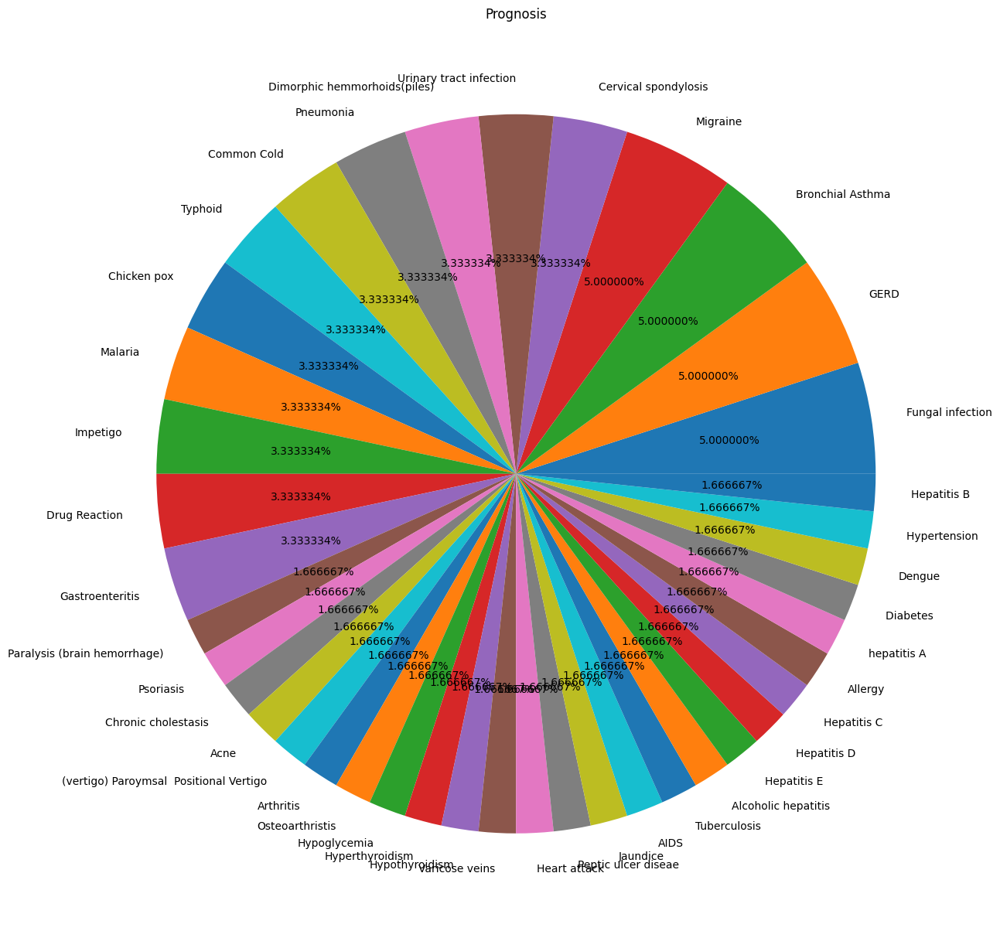

In [22]:
fig=plt.figure(figsize=(15,25))
plt.pie(value_count,labels=label,autopct='%1f%%')
plt.title('Prognosis')
plt.show()

<Axes: >

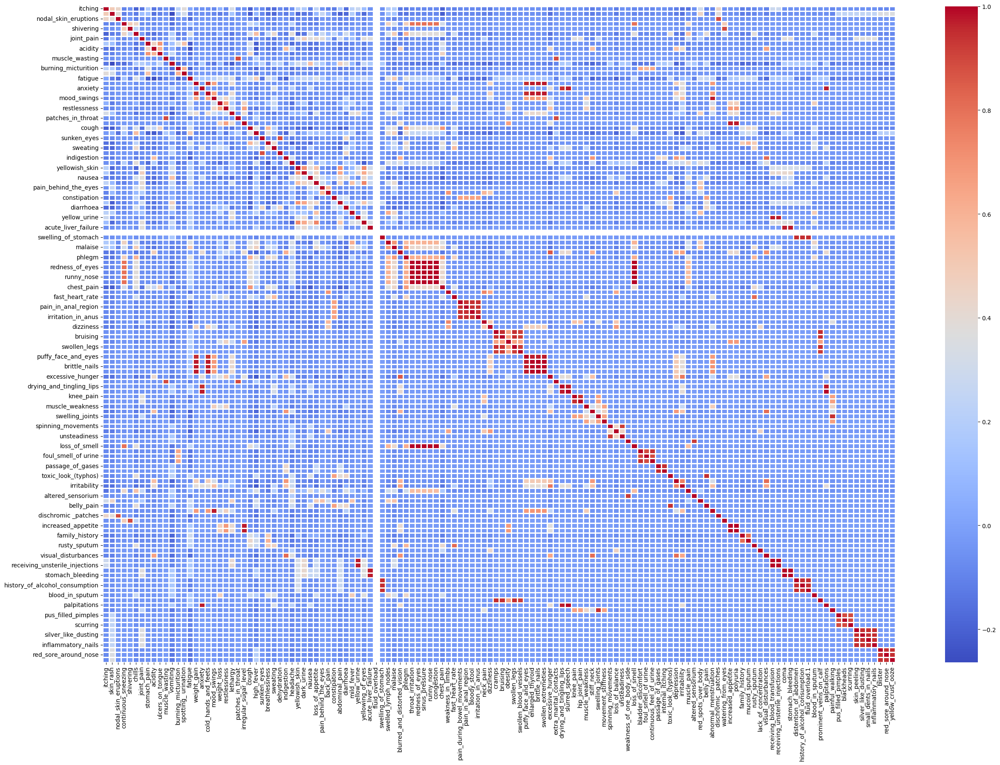

In [23]:
plt.figure(figsize=(30,20))
sns.heatmap(x.corr(),annot=False,linewidth=1 , cmap ='coolwarm')

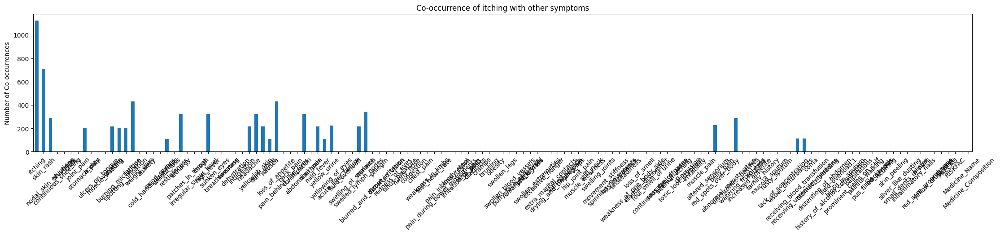

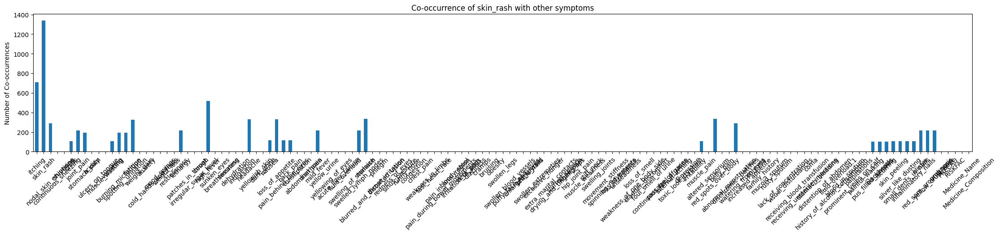

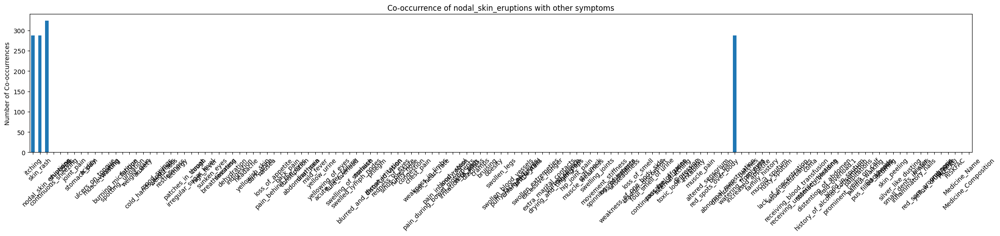

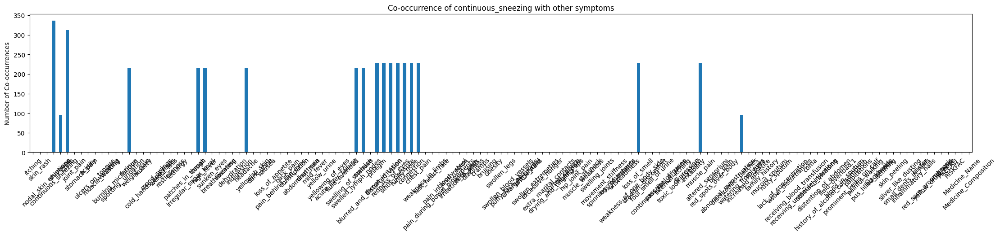

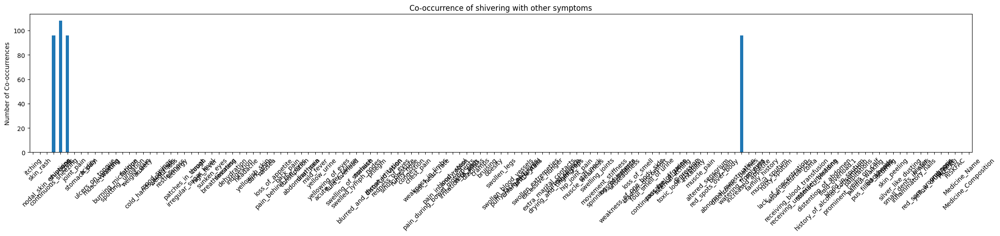

In [25]:
symptoms = df.columns[:-1]
co_occurrence_matrix = pd.DataFrame(index=symptoms, columns=symptoms, data=0)

for symptom1 in symptoms:
    for symptom2 in symptoms:
        co_occurrence_matrix.loc[symptom1, symptom2] = ((df[symptom1] == 1) & (df[symptom2] == 1)).sum()

selected_symptoms = symptoms[:5] 
for symptom in selected_symptoms:
    plt.figure(figsize=(27, 4))
    co_occurrence_matrix.loc[symptom].plot(kind='bar')
    plt.title(f'Co-occurrence of {symptom} with other symptoms')
    plt.ylabel('Number of Co-occurrences')
    plt.xticks(rotation=45)
    plt.show()

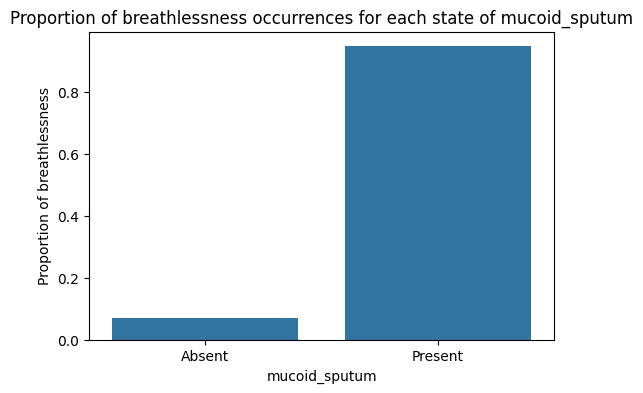

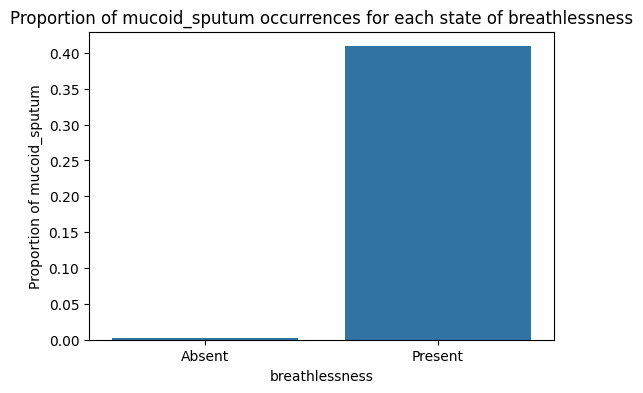

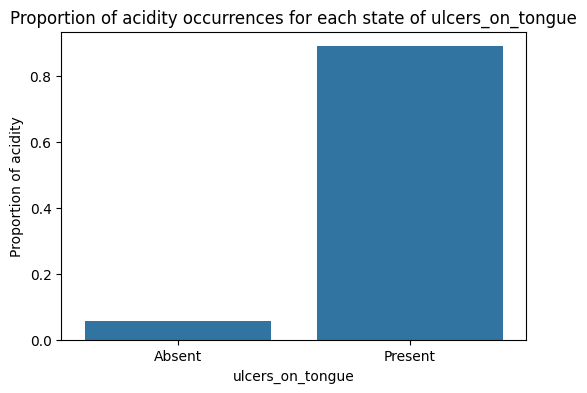

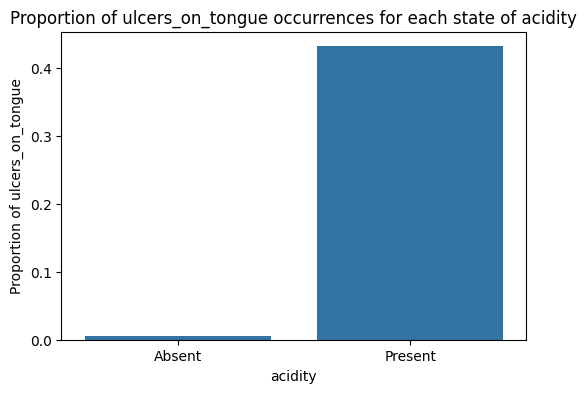

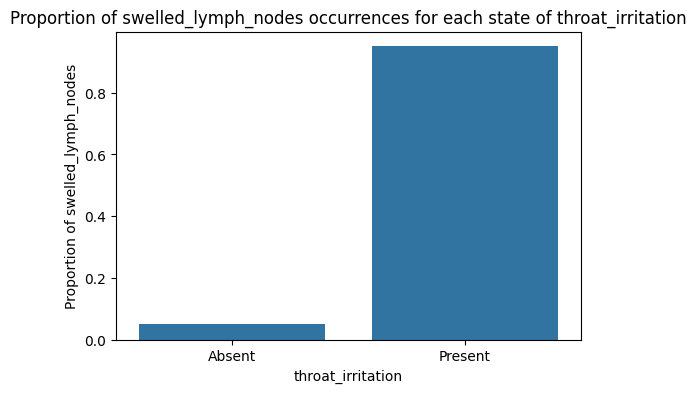

In [26]:
numeric_df = df.select_dtypes(include=[np.number])

# Calculate the correlation matrix for numeric data only
correlation_matrix = numeric_df.corr()

# Unstack the correlation matrix to handle it easily
candidate_pairs = correlation_matrix.unstack()

# Filter for somewhat correlated pairs (customize these thresholds as necessary)
somewhat_correlated_pairs = candidate_pairs[(candidate_pairs > 0.3) & (candidate_pairs < 0.6)]

# Select the highest 5 pairs
selected_pairs = somewhat_correlated_pairs.nlargest(5)

# Plot proportions of co-occurrences for each selected pair
for (symptom1, symptom2), _ in selected_pairs.items():
    proportions = numeric_df.groupby(symptom2)[symptom1].mean()
    plt.figure(figsize=(6, 4))
    sns.barplot(x=proportions.index, y=proportions.values)
    plt.title(f'Proportion of {symptom1} occurrences for each state of {symptom2}')
    plt.xlabel(symptom2)
    plt.ylabel(f'Proportion of {symptom1}')
    plt.xticks([0, 1], ['Absent', 'Present'])  # Assuming binary data
    plt.show()

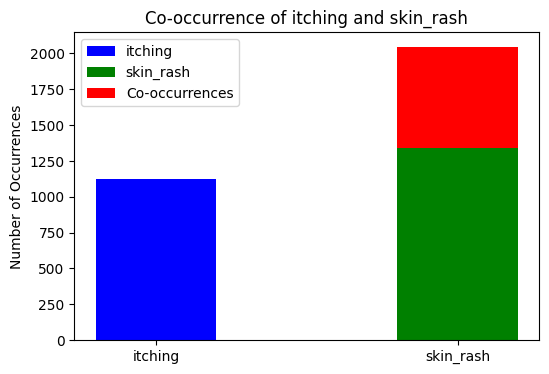

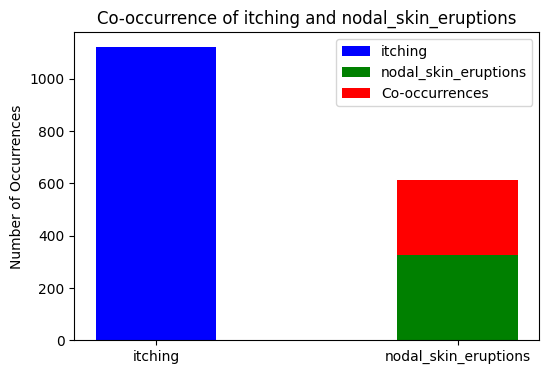

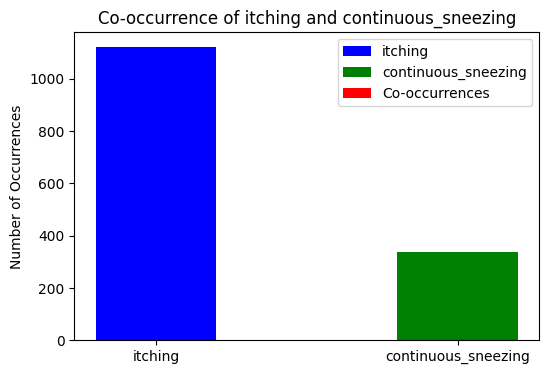

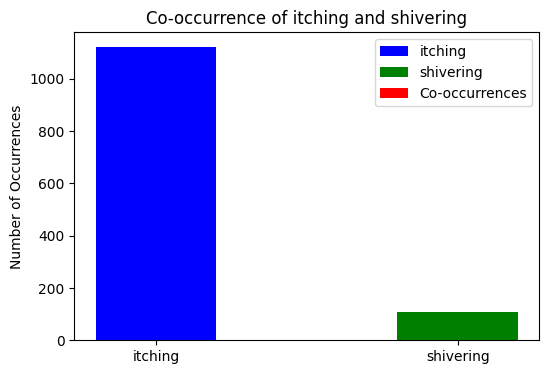

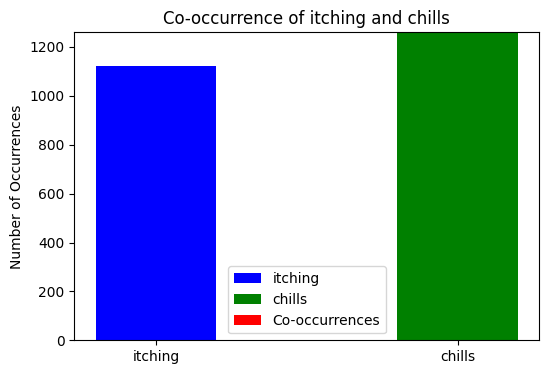

...

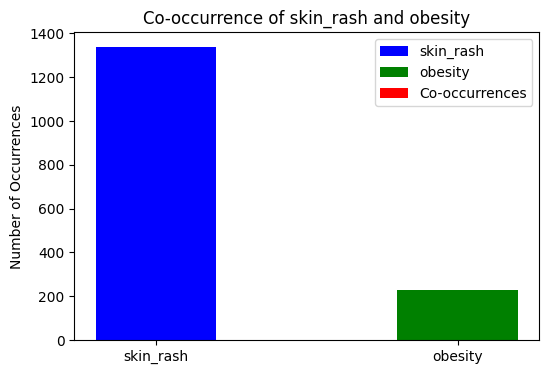

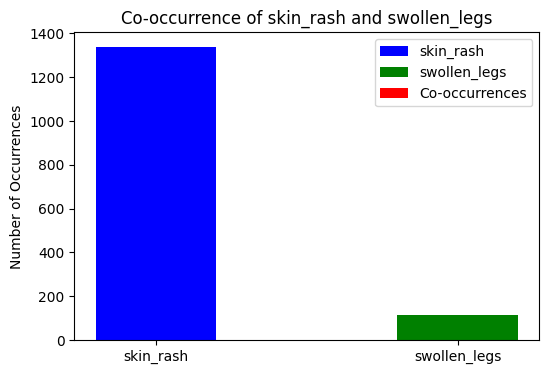

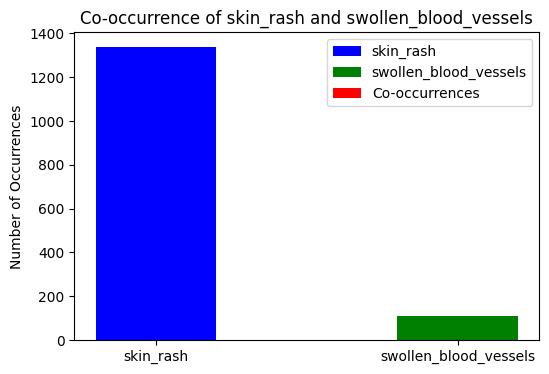

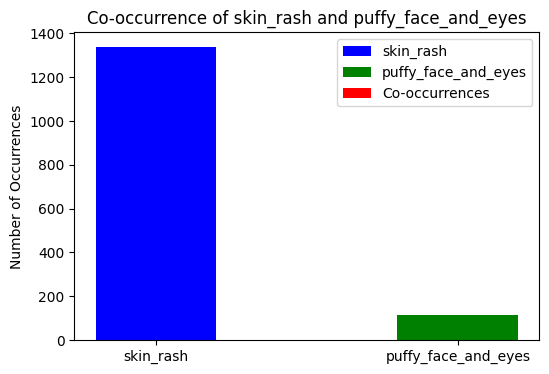

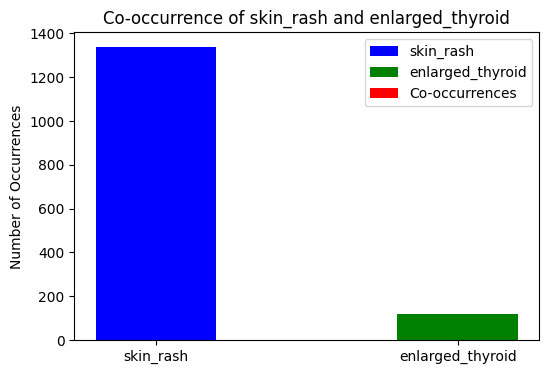

Generated 200 plots.


In [26]:
df = df.select_dtypes(include=[int, float])  # This will automatically exclude non-numeric columns if there are any

# Remove any rows with NaN values that might have resulted from non-numeric to numeric conversion
df.dropna(inplace=True)

# Get a list of symptom column names, assuming they are all except the last one
symptoms = df.columns[:-1]

def plot_symptom_co_occurrence(data, symptom1, symptom2):
    """Plot the co-occurrence of two symptoms in a bar plot."""
    count_individual1 = (data[symptom1] == 1).sum()
    count_individual2 = (data[symptom2] == 1).sum()
    co_occurrence_count = ((data[symptom1] == 1) & (data[symptom2] == 1)).sum()

    # Plotting the results
    plt.figure(figsize=(6, 4))
    bar_positions = [0, 1]  # Positions for each bar
    plt.bar(bar_positions[0], count_individual1, color='blue', width=0.4, label=symptom1)
    plt.bar(bar_positions[1], count_individual2, color='green', width=0.4, label=symptom2)
    plt.bar(bar_positions[1], co_occurrence_count, color='red', width=0.4, bottom=count_individual2, label='Co-occurrences')

    plt.ylabel('Number of Occurrences')
    plt.title(f'Co-occurrence of {symptom1} and {symptom2}')
    plt.xticks(bar_positions, [symptom1, symptom2])
    plt.legend()
    plt.show()

# Limit the number of plots to avoid excessive output
max_plots = 200
plot_count = 0

for symptom1, symptom2 in itertools.combinations(symptoms, 2):
    if plot_count >= max_plots:
        break
    plot_symptom_co_occurrence(df, symptom1, symptom2)
    plot_count += 1

print(f"Generated {plot_count} plots.")

## MOdel Building

In [29]:
X = df.iloc[:, :-6]  # features (symptoms)
y = df.iloc[:, -6] 

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [31]:
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

In [32]:
y_pred = model.predict(X_test)


In [1]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.9245367


In [36]:
from sklearn.ensemble import RandomForestClassifier

# Train a Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Prediction and Evaluation
rf_y_pred = rf_model.predict(X_test)
rf_accuracy = accuracy_score(y_test, rf_y_pred)

In [2]:
print("Random Forest Accuracy:", rf_accuracy)

Random Forest Accuracy: 0.9125672


In [35]:
from joblib import dump, load

# Assume 'model' is your trained Logistic Regression model
model_file_path = 'logistic_regression_model.joblib'
dump(model,model_file_path)
print("Model saved successfully!")

Model saved successfully!


In [36]:
loaded_model = load(model_file_path)
print("Model loaded successfully!")

Model loaded successfully!


In [37]:
print("Columns in the dataset:")
for column in df.columns:
    print(column)

Columns in the dataset:
itching
skin_rash
nodal_skin_eruptions
continuous_sneezing
shivering
chills
joint_pain
stomach_pain
acidity
ulcers_on_tongue
muscle_wasting
vomiting
burning_micturition
spotting_ urination
fatigue
weight_gain
anxiety
cold_hands_and_feets
mood_swings
weight_loss
restlessness
lethargy
patches_in_throat
irregular_sugar_level
cough
high_fever
sunken_eyes
breathlessness
sweating
dehydration
indigestion
headache
yellowish_skin
dark_urine
nausea
loss_of_appetite
pain_behind_the_eyes
back_pain
constipation
abdominal_pain
diarrhoea
mild_fever
yellow_urine
yellowing_of_eyes
acute_liver_failure
fluid_overload
swelling_of_stomach
swelled_lymph_nodes
malaise
blurred_and_distorted_vision
phlegm
throat_irritation
redness_of_eyes
sinus_pressure
runny_nose
congestion
chest_pain
weakness_in_limbs
fast_heart_rate
pain_during_bowel_movements
pain_in_anal_region
bloody_stool
irritation_in_anus
neck_pain
dizziness
cramps
bruising
obesity
swollen_legs
swollen_blood_vessels
puffy_face_

In [39]:
# symptom_names = ['symptom1', 'symptom2', 'symptom3', ..., 'symptom132']
symptom_names = [
    "itching", "skin_rash", "nodal_skin_eruptions", "continuous_sneezing", "shivering",
    "chills", "joint_pain", "stomach_pain", "acidity", "ulcers_on_tongue", "muscle_wasting",
    "vomiting", "burning_micturition", "spotting_ urination", "fatigue", "weight_gain",
    "anxiety", "cold_hands_and_feets", "mood_swings", "weight_loss", "restlessness",
    "lethargy", "patches_in_throat", "irregular_sugar_level", "cough", "high_fever",
    "sunken_eyes", "breathlessness", "sweating", "dehydration", "indigestion", "headache",
    "yellowish_skin", "dark_urine", "nausea", "loss_of_appetite", "pain_behind_the_eyes",
    "back_pain", "constipation", "abdominal_pain", "diarrhoea", "mild_fever", "yellow_urine",
    "yellowing_of_eyes", "acute_liver_failure", "fluid_overload", "swelling_of_stomach",
    "swelled_lymph_nodes", "malaise", "blurred_and_distorted_vision", "phlegm",
    "throat_irritation", "redness_of_eyes", "sinus_pressure", "runny_nose", "congestion",
    "chest_pain", "weakness_in_limbs", "fast_heart_rate", "pain_during_bowel_movements",
    "pain_in_anal_region", "bloody_stool", "irritation_in_anus", "neck_pain", "dizziness",
    "cramps", "bruising", "obesity", "swollen_legs", "swollen_blood_vessels",
    "puffy_face_and_eyes", "enlarged_thyroid", "brittle_nails", "swollen_extremeties",
    "excessive_hunger", "extra_marital_contacts", "drying_and_tingling_lips", "slurred_speech",
    "knee_pain", "hip_joint_pain", "muscle_weakness", "stiff_neck", "swelling_joints",
    "movement_stiffness", "spinning_movements", "loss_of_balance", "unsteadiness",
    "weakness_of_one_body_side", "loss_of_smell", "bladder_discomfort", "foul_smell_of urine",
    "continuous_feel_of_urine", "passage_of_gases", "internal_itching", "toxic_look_(typhos)",
    "depression", "irritability", "muscle_pain", "altered_sensorium", "red_spots_over_body",
    "belly_pain", "abnormal_menstruation", "dischromic _patches", "watering_from_eyes",
    "increased_appetite", "polyuria", "family_history", "mucoid_sputum", "rusty_sputum",
    "lack_of_concentration", "visual_disturbances", "receiving_blood_transfusion",
    "receiving_unsterile_injections", "coma", "stomach_bleeding", "distention_of_abdomen",
    "history_of_alcohol_consumption", "fluid_overload.1", "blood_in_sputum",
    "prominent_veins_on_calf", "palpitations", "painful_walking", "pus_filled_pimples",
    "blackheads", "scurring", "skin_peeling", "silver_like_dusting", "small_dents_in_nails",
    "inflammatory_nails", "blister", "red_sore_around_nose", "yellow_crust_ooze"
]



# Function to take user input for symptoms
def get_user_input(symptom_names):
    print("Please enter the symptom values (1 for presence, 0 for absence):")
    user_input = {}
    for symptom in symptom_names:
        # Secure way to handle user input:
        valid_input = False
        while not valid_input:
            try:
                value = input(f"{symptom}: ")
                value = int(value)  # Convert input to integer
                if value in [0, 1]:
                    user_input[symptom] = value
                    valid_input = True
                else:
                    print("Please enter 0 or 1.")
            except ValueError:
                print("Invalid input. Please enter a number.")
    
    # Convert user input into DataFrame
    user_input_df = pd.DataFrame([user_input])
    return user_input_df

# Get user input
user_input_df = get_user_input(symptom_names)

# Predict the prognosis using the loaded model
user_prediction = model.predict(user_input_df)
print("Predicted prognosis:")
print(user_prediction[0])

details = df[df['prognosis'] == user_prediction[0]].iloc[0]
print("\nAdditional Details:")
print(f"Precautions: {details['PRECAU']}")
print(f"Risk Factors: {details['RISKFAC']}")
print(f"Medicine Name: {details['Medicine_Name']}")
print(f"Medicine Composition: {details['Medicine_Composition']}")
print(f"Medicine Description: {details['Medicine_Description']}")

Please enter the symptom values (1 for presence, 0 for absence):
Predicted prognosis:
Fungal infection

Additional Details:
Precautions: Bath twice, use dettol or neem in bathing water, keep infected area dry, use clean cloths

Risk Factors: Colonization, broad-spectrum antibiotics, indwelling central catheter
Medicine Name: Antifungal cream
Medicine Composition: clotrimazole, econazole, ketoconazole, miconazole, tioconazole, terbinafine, and amorolfine
Medicine Description: a pharmaceutical fungicide or fungistatic used to treat and prevent mycosis
